# Trend COVID-19 Italia

Analisi dati relativi all'epidemia di COVID-19 scoppiata nel 2020 in Italia.

Fonte dati: <https://github.com/pcm-dpc/COVID-19>

Codice rilasciato in licenza MIT: <https://opensource.org/licenses/MIT>

Autore: *Emanuele Zeppieri*

In [1]:
import itertools
import functools
import os
import math

import numpy as np
import pandas as pd

import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.patheffects as pe

DEFAULT_FONT_SIZE = 13

from matplotlib import rcParams
rcParams['font.family'] = 'serif'
rcParams['font.serif'] = ['Century Schoolbook']
rcParams['font.size'] = DEFAULT_FONT_SIZE
rcParams['figure.dpi'] = 300
rcParams['xtick.minor.size'] = rcParams['xtick.major.size']
rcParams['text.usetex'] = False
from matplotlib.markers import CARETDOWNBASE, CARETUPBASE
import matplotlib.dates as mdates

import datetime as dt
from datetime import date, datetime, timedelta

import locale
locale.setlocale(locale.LC_ALL, 'it_IT')

from ETL_utilities import (
    it_data_load, fix_2020_03_10, add_delta_growth_perc, add_ra, add_ra_days,
    reg_data_load, regional_data_reshaping, make_regions_group_w_ra, localize_plot_column,
    province_data_load, province_data_reshaping, make_province_group_w_ra, fix_2020_08_15, fix_2020_08_17
)
from formatting_utilities import format_dates, format_dates_from_numbers, LegendTitle
from file_utilities import save_in_dir
from common_data import REGIONS_POP

%load_ext autoreload
%autoreload 2

# Global constants
# PLEASE CUSTOMIZE
OUTPUT_PATH = '../output'

In [2]:
# Caricamento dei dati dalla Protezione Civile
ds_it = it_data_load()

In [3]:
# Sanity check
ds_it.tail(10)

,stato,ricoverati_con_sintomi,terapia_intensiva,totale_ospedalizzati,isolamento_domiciliare,totale_positivi,variazione_totale_positivi,nuovi_positivi,dimessi_guariti,deceduti,casi_da_sospetto_diagnostico,casi_da_screening,totale_casi,tamponi,casi_testati,note
data,,,,,,,,,,,,,,,,
2020-08-11,ITA,801,49,850,12711,13561,193,412,202461,35215,223674.0,27563.0,251237,7316918,4329697.0,NaN
2020-08-12,ITA,779,53,832,12959,13791,230,481,202697,35225,223844.0,27869.0,251713,7369576,4357027.0,NaN
2020-08-13,ITA,786,55,841,13240,14081,290,523,202923,35231,224058.0,28177.0,252235,7420764,4382656.0,NaN
2020-08-14,ITA,771,56,827,13422,14249,168,574,203326,35234,224319.0,28490.0,252809,7467487,4407524.0,NaN
2020-08-15,ITA,764,55,819,13587,14406,157,629,203640,35392,224521.0,28917.0,253438,7520610,4433461.0,NaN
2020-08-16,ITA,787,56,843,13890,14733,327,479,203786,35396,224694.0,29221.0,253915,7557417,4455931.0,NaN
2020-08-17,ITA,810,58,868,13999,14867,134,320,203968,35400,224812.0,29423.0,254235,7588083,4477310.0,NaN
2020-08-18,ITA,843,58,901,14188,15089,222,403,204142,35405,224974.0,29662.0,254636,7642059,4509997.0,NaN
2020-08-19,ITA,866,66,932,14428,15360,271,642,204506,35412,225215.0,30063.0,255278,7713154,4551287.0,NaN


In [4]:
fix_2020_03_10(ds_it) # Correzione dati errati 2020-03-10 nazionali

In [5]:
add_delta_growth_perc(ds_it)
add_ra(ds_it)

In [6]:
# Check
#ds_it.head()
ds_it.loc[:, [
    'totale_casi', 'totale_casi_DELTA', 'tamponi_DELTA', 'casi_testati_DELTA',
    'dimessi_guariti', 'deceduti', 'deceduti_DELTA', 'dimessi_guariti_DELTA', 'positive_test_diagnostici_RATIO_100',
    'totale_ospedalizzati_DELTA', 'terapia_intensiva_DELTA', 'casi_da_screening_DELTA','casi_da_sospetto_diagnostico_DELTA',
    'totale_ospedalizzati_RATIO', 'terapia_intensiva_RATIO'
]].tail(10)

,totale_casi,totale_casi_DELTA,tamponi_DELTA,casi_testati_DELTA,dimessi_guariti,deceduti,deceduti_DELTA,dimessi_guariti_DELTA,positive_test_diagnostici_RATIO_100,totale_ospedalizzati_DELTA,terapia_intensiva_DELTA,casi_da_screening_DELTA,casi_da_sospetto_diagnostico_DELTA,totale_ospedalizzati_RATIO,terapia_intensiva_RATIO
data,,,,,,,,,,,,,,,
2020-08-11,251237,412,40642.0,22063.0,202461,35215,6.0,213.0,1.87,25.0,3.0,294.0,118.0,0.062680,0.003613
2020-08-12,251713,481,52658.0,27330.0,202697,35225,10.0,236.0,1.76,-18.0,4.0,306.0,170.0,0.060329,0.003843
2020-08-13,252235,523,51188.0,25629.0,202923,35231,6.0,226.0,2.04,9.0,2.0,308.0,214.0,0.059726,0.003906
2020-08-14,252809,574,46723.0,24868.0,203326,35234,3.0,403.0,2.31,-14.0,1.0,313.0,261.0,0.058039,0.003930
2020-08-15,253438,629,53123.0,25937.0,203640,35392,4.0,314.0,2.43,-8.0,-1.0,427.0,202.0,0.056851,0.003818
2020-08-16,253915,479,36807.0,22470.0,203786,35396,4.0,146.0,2.13,24.0,1.0,304.0,173.0,0.057218,0.003801
2020-08-17,254235,320,30666.0,21379.0,203968,35400,4.0,182.0,1.50,25.0,2.0,202.0,118.0,0.058384,0.003901
2020-08-18,254636,403,53976.0,32687.0,204142,35405,5.0,174.0,1.23,33.0,0.0,239.0,162.0,0.059712,0.003844
2020-08-19,255278,642,71095.0,41290.0,204506,35412,7.0,364.0,1.55,31.0,8.0,401.0,241.0,0.060677,0.004297


In [7]:
SUBTITLE = 'Fonte: Protezione Civile Italia - https://github.com/pcm-dpc/COVID-19 (dati del 10/03/2020 corretti)\nCodice libero: https://github.com/emazep/COVID-19-Statistics'
SUBTITLE_NO_CORR = 'Fonte: Protezione Civile Italia - https://github.com/pcm-dpc/COVID-19\nCodice libero: https://github.com/emazep/COVID-19-Statistics'
SUBTITLE_NO_CORR_ISTAT = 'Fonte: Protezione Civile Italia - https://github.com/pcm-dpc/COVID-19; Istat - http://dati.istat.it/Index.aspx?DataSetCode=DCIS_POPRES1\nCodice libero: https://github.com/emazep/COVID-19-Statistics'

common_plt_params = {'marker':'o', 'markersize':8, 'linewidth':4}
small_plt_params = {'marker':'o', 'markersize':4, 'linewidth':2}

common_plt_params_no_dots = {'linewidth':4}
small_plt_params_no_dots = {'linewidth':2}

DATE_SIZE = 6
DATE_SIZE_BIG = 10

GLOBAL_SLACK = 0.54
TAMPONI_MEAN_SLACK = 0.0045

pe_outline = pe.withStroke(linewidth=3.8, foreground='black')
pe_shadow = pe.SimpleLineShadow(offset=(0,-2.8), alpha=0.4)
pe_normal = pe.Normal()

ma_format = {
    'color': 'yellow',
    'linewidth': 2,
    'path_effects': [pe_outline, pe_shadow, pe_normal]
}

In [8]:
MIN_DATE = ds_it.index.min()
MAX_DATE = ds_it.index.max()

DAYS_AGO_90 = MAX_DATE - timedelta(days=90)

ds_it_last_90_days = ds_it[DAYS_AGO_90:]

def set_xlim(ax, slack=0, left=MIN_DATE, right=MAX_DATE):
    ax.set_xlim(left=left, right=right)
    ax.set_xlim(ax.get_xlim()[0]-slack, ax.get_xlim()[1]+slack)

def set_xlim_num(ax, slack=0, min_x=0, max_x=200):
    ax.set_xlim(left=min_x, right=max_x)
    ax.set_xlim(ax.get_xlim()[0]-slack, ax.get_xlim()[1]+slack)

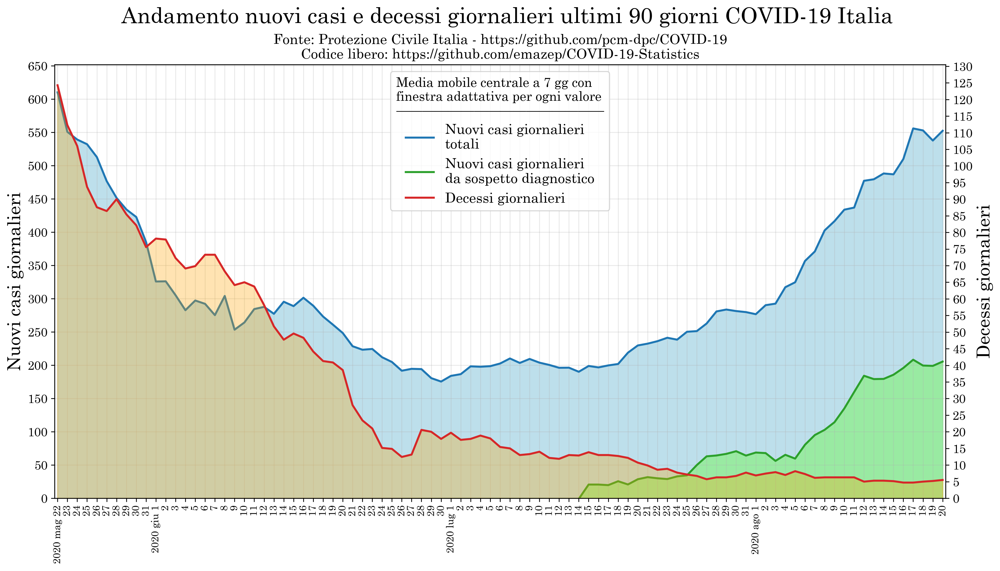

In [9]:
# Last 90 days flows
SLACK = 0.3
ALPHA = 0.3

_, ax = plt.subplots(figsize=(16,8))

ax.plot(
    ds_it_last_90_days.index, ds_it_last_90_days['totale_casi_DELTA_RA_7'],
    label='Nuovi casi giornalieri\ntotali',  **small_plt_params_no_dots, color='tab:blue'
)
#ax = ds_it_last_90_days.plot(y='totale_casi_DELTA_RA_7', label='Nuovi casi giornalieri totali', figsize=(16, 8), **small_plt_params_no_dots)
plt.fill_between(ds_it_last_90_days.index, ds_it_last_90_days['totale_casi_DELTA_RA_7'], color='lightblue', alpha=0.8)

ax.plot(
    ds_it_last_90_days.index, ds_it_last_90_days['casi_da_sospetto_diagnostico_DELTA_RA_7'],
    label='Nuovi casi giornalieri\nda sospetto diagnostico',  **small_plt_params_no_dots, color='tab:green'
)
plt.fill_between(ds_it_last_90_days.index, ds_it_last_90_days['casi_da_sospetto_diagnostico_DELTA_RA_7'], color='lightgreen', alpha=0.8)

ax2 = ax.twinx()

ax2.plot(
    ds_it_last_90_days.index, ds_it_last_90_days['deceduti_DELTA_RA_7'],
    label='Decessi giornalieri',  **small_plt_params_no_dots, color='tab:red'
)
plt.fill_between(ds_it_last_90_days.index, ds_it_last_90_days['deceduti_DELTA_RA_7'], color='orange', alpha=0.3)

set_xlim(ax, SLACK, left=DAYS_AGO_90)
ax.set_ylim(bottom=0)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE_BIG, rotation=90)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(50))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=12)

ax.set_ylabel('Nuovi casi giornalieri', fontsize=18)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both')

ax2.yaxis.set_major_locator(ticker.MultipleLocator(5))
ax2.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax2.tick_params(axis='y', which='both', labelsize=12)
ax2.set_ylabel('Decessi giornalieri', fontsize=18)
ax2.set_ylim(bottom=0)

ax.set_xlabel(None)
ax2.set_xlabel(None)

# Ask matplotlib for primary y axes labels
handles, labels = ax.get_legend_handles_labels()
# Ask matplotlib for secondary y axes labels
handles2, labels2 = ax2.get_legend_handles_labels()

sep = '\n————————————————'
ax2.legend(
    handles+handles2, labels+labels2,
    title='Media mobile centrale a 7 gg con\nfinestra adattativa per ogni valore'+sep,
    fontsize=14, loc='upper center'
)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('       Andamento nuovi casi e decessi giornalieri ultimi 90 giorni COVID-19 Italia', fontsize=22)

fig_90_days_daily_cases_deaths = plt.gcf()

plt.show()

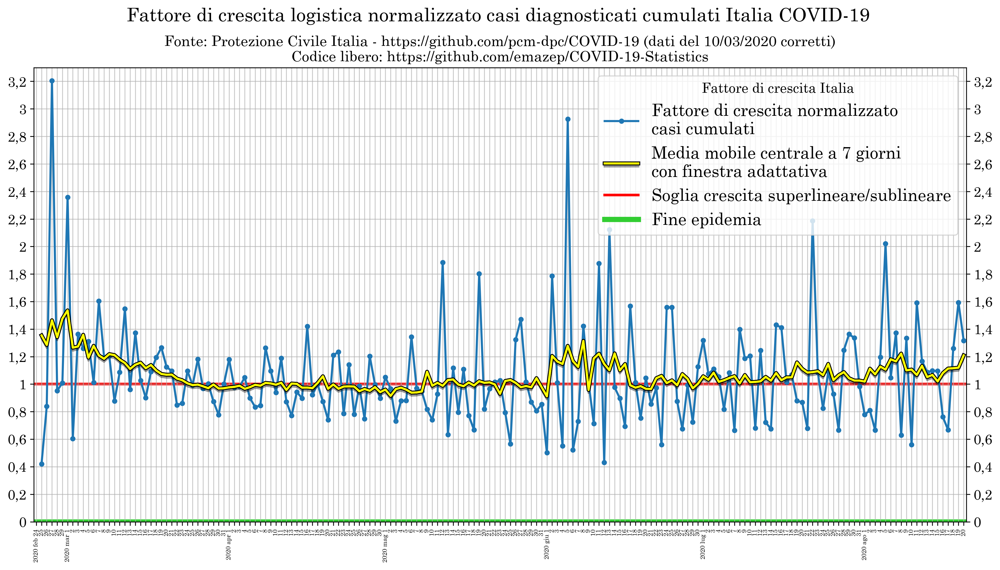

In [10]:
# Growth factor
SLACK = 0.5
ALPHA = 0.7
LINE_COLOR = 'yellow'
BORDER_COLOR = 'black'

ax = ds_it.plot(
    y='growth_factor_cum_infected', label='Fattore di crescita normalizzato\ncasi cumulati', **small_plt_params, figsize=(16, 8), zorder=3
)
ax.plot(
    ds_it.index, ds_it['growth_factor_cum_infected_RA_7'], label='Media mobile centrale a 7 giorni\ncon finestra adattativa',
    zorder=4, **ma_format
)
plt.axhline(y=1, color='red', linewidth=2.5, zorder=0, alpha=1, label='Soglia crescita superlineare/sublineare')
plt.axhline(y=0, color='limegreen', linewidth=5, zorder=0, alpha=1, label='Fine epidemia')

set_xlim(ax, SLACK)
ax.set_ylim(bottom=0)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE, rotation=90)

ax.yaxis.set_major_locator(ticker.MultipleLocator(0.2))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.set_ylim(top=3.3)

ax.grid(which='both', alpha=ALPHA)

ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

ax.legend(title="Fattore di crescita Italia", fontsize=16)

ax.set_title(SUBTITLE, fontsize=14)
plt.suptitle('     Fattore di crescita logistica normalizzato casi diagnosticati cumulati Italia COVID-19', fontsize=18)

fig_growth = plt.gcf()

plt.show()

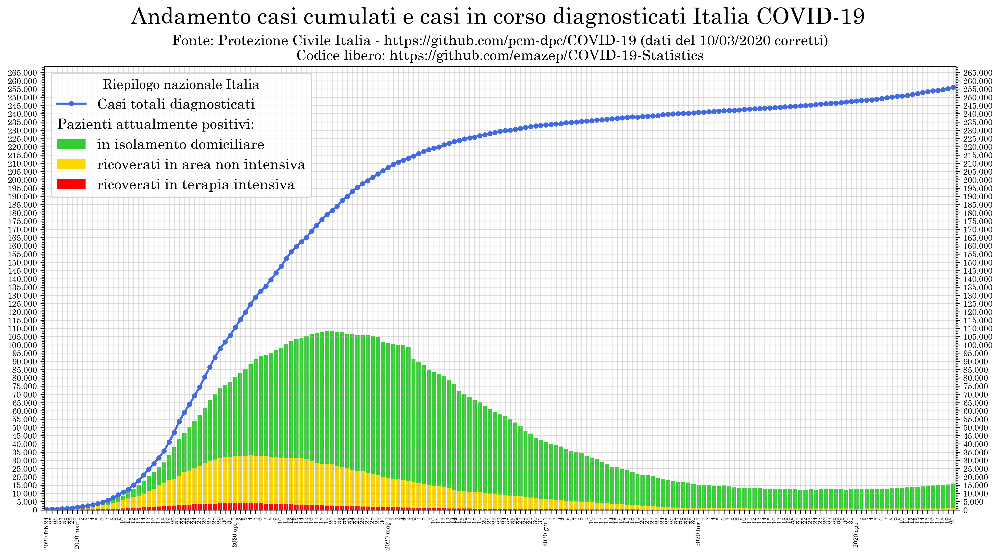

In [11]:
# Cases trend
SLACK = 0.54

ALPHA = 0.4

ax = ds_it.plot(y='totale_casi', label='Casi totali diagnosticati', **small_plt_params, figsize=(16, 8), zorder=3, color='royalblue')
ax.bar(ds_it.index, ds_it['isolamento_domiciliare'], label='in isolamento domiciliare', bottom=ds_it['terapia_intensiva']+ds_it['ricoverati_con_sintomi'], color='limegreen')
ax.bar(ds_it.index, ds_it['ricoverati_con_sintomi'], label='ricoverati in area non intensiva', bottom=ds_it['terapia_intensiva'], color='gold')
ax.bar(ds_it.index, ds_it['terapia_intensiva'], label='ricoverati in terapia intensiva', color='red')

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE, rotation=90)
ax.xaxis.grid(True, which='both', alpha=ALPHA)

ax.yaxis.grid(True, which='major', alpha=ALPHA)
ax.yaxis.set_major_locator(ticker.MultipleLocator(5_000))
ax.yaxis.set_minor_locator(ticker.MultipleLocator(1_000))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=8)

ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

handles, labels = ax.get_legend_handles_labels()
handles.insert(1, 'Pazienti attualmente positivi:')
labels.insert(1, '')
ax.legend(handles, labels, title="Riepilogo nazionale Italia", fontsize=14, handler_map={str: LegendTitle({'fontsize': 14})})

ax.set_title(SUBTITLE, fontsize=14)
plt.suptitle('    Andamento casi cumulati e casi in corso diagnosticati Italia COVID-19', fontsize=22)

fig_trend = plt.gcf()

plt.show()

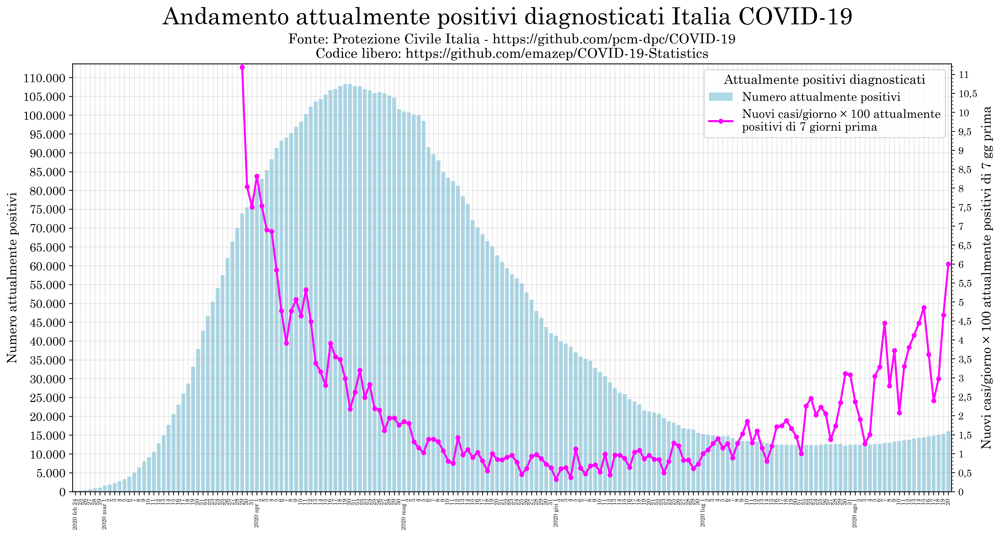

In [12]:
# Current

ALPHA = 0.3
SLACK = 0.6

_, ax = plt.subplots(figsize=(16,8))

ax.bar(ds_it.index, ds_it['totale_positivi'], label='Numero attualmente positivi', color='lightblue')

ax2 = ax.twinx()

'''
ax2.plot(
    ds_it.index, ds_it['totale_casi_DELTA_RATIO'], label='Nuovi casi/giorno × 100 attualmente positivi',
    linewidth=2.5, markersize=5, marker='o', zorder=3, color='darkviolet'
)
'''

x = ds_it.index
y = ds_it['totale_casi_DELTA_RATIO-7']
ax2.plot(
    x, y, label='Nuovi casi/giorno × 100 attualmente\npositivi di 7 giorni prima',
    **small_plt_params, zorder=3, color='magenta'
)

'''
CLIP_DATE = dt.date(2020, 3, 9)
for i, j in zip(x,y):
    if i < CLIP_DATE or math.isnan(j):
        continue
    YSLACK = -0.075 if i == CLIP_DATE else 0.05
    ax2.annotate(
        f'{round(j*100,1):n}', xy=(i,j), xytext=(i, j+YSLACK),
        fontsize=8, bbox=dict(boxstyle='round', facecolor='yellow', alpha=0.5), annotation_clip=True
    )
'''

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE, rotation=90)

ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(5000))
ax.yaxis.set_major_formatter(ticker.ScalarFormatter())
ax.tick_params(axis='y', which='major', labelsize=12)
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.set_ylabel('Numero attualmente positivi')

ax.grid(which='major', alpha=ALPHA)

plt.xlabel(None)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('   Andamento attualmente positivi diagnosticati Italia COVID-19', fontsize=24)

ax2.set_ylabel('Nuovi casi/giorno × 100 attualmente positivi di 7 gg prima')

ax2.set_ylim(bottom=0, top=0.1128)

ax2.yaxis.set_major_locator(ticker.MultipleLocator(0.005))
ax2.yaxis.set_minor_locator(ticker.MultipleLocator(0.001))
ax2.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x*100:n}'))
ax2.tick_params(axis='y', which='major', labelsize=10)

# Ask matplotlib for primary y axes labels
handles, labels = ax.get_legend_handles_labels()
# Ask matplotlib for secondary y axes labels
handles2, labels2 = ax2.get_legend_handles_labels()

sep = '\n————————————————'
ax2.legend(
    handles+handles2, labels+labels2,
    title='Attualmente positivi diagnosticati',
    fontsize=12, loc='best'
)

fig_current = plt.gcf()

plt.show()

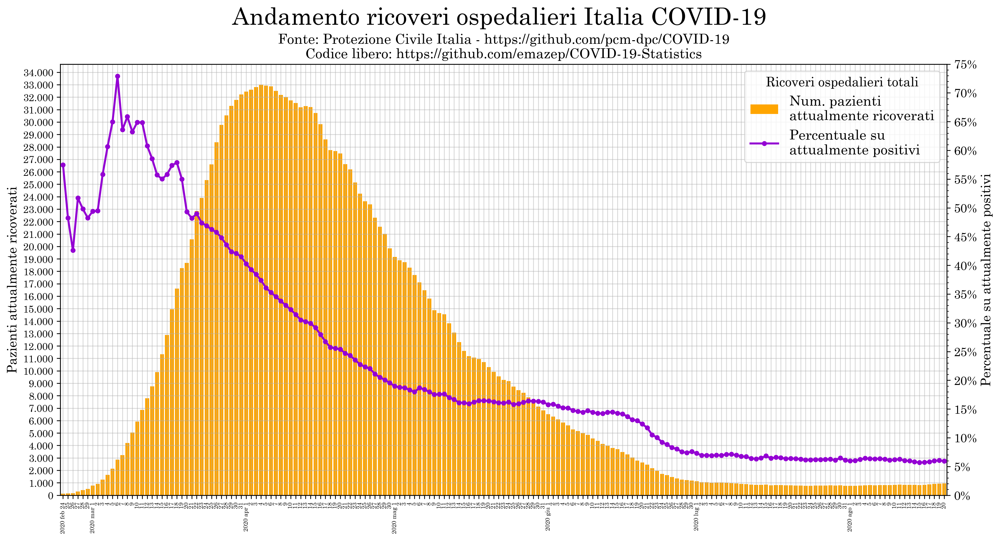

In [13]:
ALPHA = 0.5
SLACK = 0.54

# Tests trend
_, ax = plt.subplots(figsize=(16,8))

ax.bar(ds_it.index, ds_it['totale_ospedalizzati'], label='Num. pazienti\nattualmente ricoverati', color='orange')

ax2 = ax.twinx()

ax2.plot(
    ds_it.index, ds_it['totale_ospedalizzati_RATIO'], label='Percentuale su\nattualmente positivi',
    **small_plt_params, zorder=3, color='darkviolet'
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE, rotation=90)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(1000))
ax.yaxis.set_major_formatter(ticker.ScalarFormatter())
ax.tick_params(axis='y', which='both', labelsize=10)
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.set_ylabel('Pazienti attualmente ricoverati')

ax.grid(which='major', alpha=ALPHA)

plt.xlabel(None)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('   Andamento ricoveri ospedalieri Italia COVID-19', fontsize=24)

ax2.set_ylabel('Percentuale su attualmente positivi')

ax2.set_ylim(bottom=0, top=0.75)

ax2.yaxis.set_major_locator(ticker.MultipleLocator(0.05))
ax2.yaxis.set_minor_locator(ticker.MultipleLocator(0.01))
ax2.yaxis.set_major_formatter(ticker.PercentFormatter(xmax=1, decimals=0))
ax2.tick_params(axis='y', which='both', labelsize=12)

# Ask matplotlib for primary y axes labels
handles, labels = ax.get_legend_handles_labels()
# Ask matplotlib for secondary y axes labels
handles2, labels2 = ax2.get_legend_handles_labels()

sep = '\n————————————————'
ax2.legend(
    handles+handles2, labels+labels2,
    title='Ricoveri ospedalieri totali',
    fontsize=14, loc='upper right'
)

fig_hospital = plt.gcf()

plt.show()

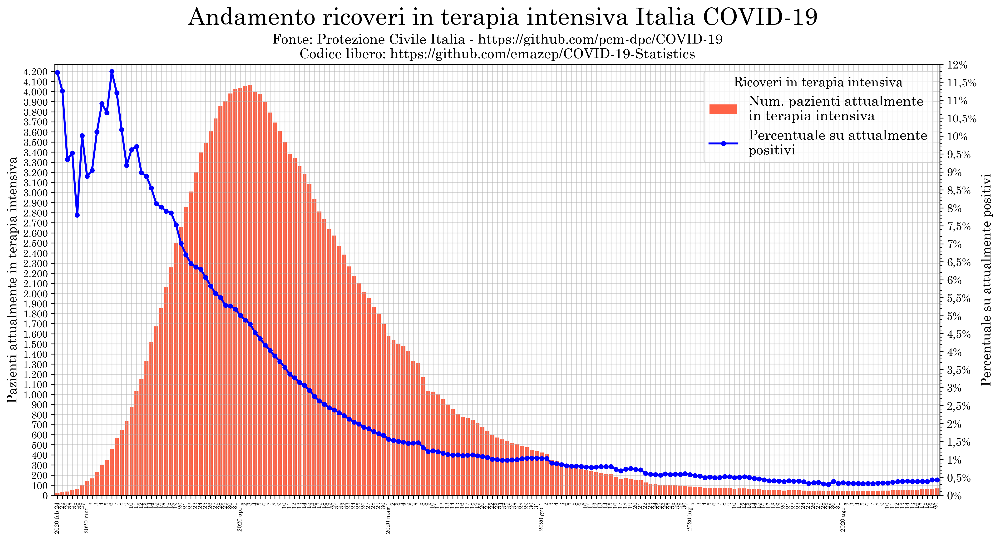

In [14]:
ALPHA = 0.5
SLACK = 0.54

# Tests trend
_, ax = plt.subplots(figsize=(16,8))

ax.bar(ds_it.index, ds_it['terapia_intensiva'], label='Num. pazienti attualmente\nin terapia intensiva', color='tomato')

ax2 = ax.twinx()

ax2.plot(
    ds_it.index, ds_it['terapia_intensiva_RATIO'], label='Percentuale su attualmente\npositivi',
    **small_plt_params, zorder=3, color='blue'
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE, rotation=90)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(100))
ax.yaxis.set_major_formatter(ticker.ScalarFormatter())
ax.tick_params(axis='y', which='both', labelsize=8)
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.set_ylabel('Pazienti attualmente in terapia intensiva')
ax.tick_params(axis='y', which='both', labelsize=10)

ax.grid(which='major', alpha=ALPHA)

plt.xlabel(None)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('      Andamento ricoveri in terapia intensiva Italia COVID-19', fontsize=24)

ax2.set_ylabel('Percentuale su attualmente positivi')

ax2.set_ylim(bottom=0, top=0.12)

ax2.yaxis.set_major_locator(ticker.MultipleLocator(0.005))
ax2.yaxis.set_minor_locator(ticker.MultipleLocator(0.001))
ax2.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x*100:n}' + '%'))
ax2.tick_params(axis='y', which='both', labelsize=11)

# Ask matplotlib for primary y axes labels
handles, labels = ax.get_legend_handles_labels()
# Ask matplotlib for secondary y axes labels
handles2, labels2 = ax2.get_legend_handles_labels()

sep = '\n————————————————'
ax2.legend(
    handles+handles2, labels+labels2,
    title='Ricoveri in terapia intensiva',
    fontsize=14, loc='upper right'
)

fig_ICU = plt.gcf()

plt.show()

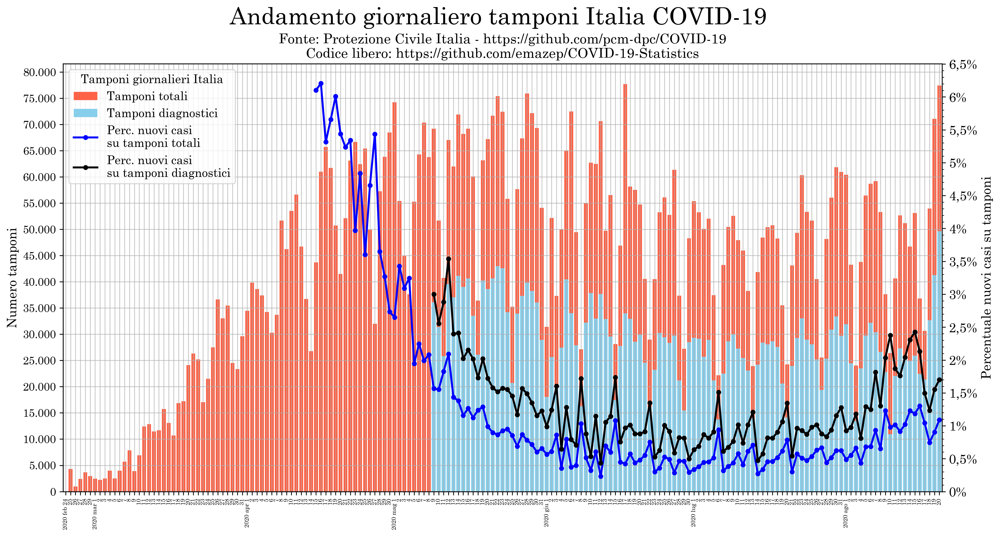

In [15]:
ALPHA = 0.7
SLACK = GLOBAL_SLACK

PERC_COLOR = 'darkviolet'
NEGATIVE_COLOR = 'limegreen'
POSITIVE_COLOR = 'red'

# Tests trend
_, ax = plt.subplots(figsize=(16,8))


ax.bar(
    ds_it.index, ds_it['tamponi_DELTA'],
    label='Tamponi totali', color='tomato'
)
ax.bar(ds_it.index, ds_it['casi_testati_DELTA_fixed'], label='Tamponi diagnostici', color='skyblue')

ax2 = ax.twinx()
ax2.plot(
    ds_it.index, ds_it['positive_test_RATIO'],
    label='Perc. nuovi casi\nsu tamponi totali', **small_plt_params, zorder=3, color='blue'
)
ax2.plot(
    ds_it.index, ds_it['positive_test_diagnostici_RATIO'],
    label='Perc. nuovi casi\nsu tamponi diagnostici', **small_plt_params, zorder=3, color='black'
)


'''
ax.bar(ds_it.index, ds_it['tamponi_negativi'], label='Tamponi meno nuovi casi', color=NEGATIVE_COLOR, bottom=ds_it['totale_casi_DELTA'])
ax.bar(ds_it.index, ds_it['totale_casi_DELTA'], label='Nuovi casi', color=POSITIVE_COLOR)

ax2 = ax.twinx()
ax2.plot(ds_it.index, ds_it['positive_test_RATIO'], label='Perc. nuovi casi\nsu tamponi', **small_plt_params, zorder=3, color=PERC_COLOR)

ax2.axhline(
    y=ds_it['positive_test_RATIO'].mean(), zorder=0, label='Media perc. nuovi\ncasi su tamponi',
    color='skyblue', **small_plt_params, alpha=1,
    xmin=(17/ds_it.index.size)-TAMPONI_MEAN_SLACK
)
'''
set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE, rotation=90)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(5_000))
ax.yaxis.set_major_formatter(ticker.ScalarFormatter())
ax.tick_params(axis='y', which='both', labelsize=11)
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.set_ylabel('Numero tamponi')

ax.grid(which='major', alpha=ALPHA)

plt.xlabel(None)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('   Andamento giornaliero tamponi Italia COVID-19', fontsize=24)

ax2.set_ylabel('Percentuale nuovi casi su tamponi')

ax2.set_ylim(bottom=0)

ax2.yaxis.set_major_locator(ticker.MultipleLocator(0.005))
ax2.yaxis.set_minor_locator(ticker.MultipleLocator(0.001))
ax2.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x*100:n}'+'%'))
#ax2.yaxis.set_major_formatter(ticker.PercentFormatter(xmax=1, decimals=1))

# Ask matplotlib for primary y axes labels
handles, labels = ax.get_legend_handles_labels()
# Ask matplotlib for secondary y axes labels
handles2, labels2 = ax2.get_legend_handles_labels()

rcParams['font.size'] = 12

sep = '\n————————————————'
ax2.legend(
    handles+handles2, labels+labels2,
    title='Tamponi giornalieri Italia',
    fontsize=12, loc='upper left'
)

fig_tests = plt.gcf()
plt.show()

rcParams['font.size'] = DEFAULT_FONT_SIZE

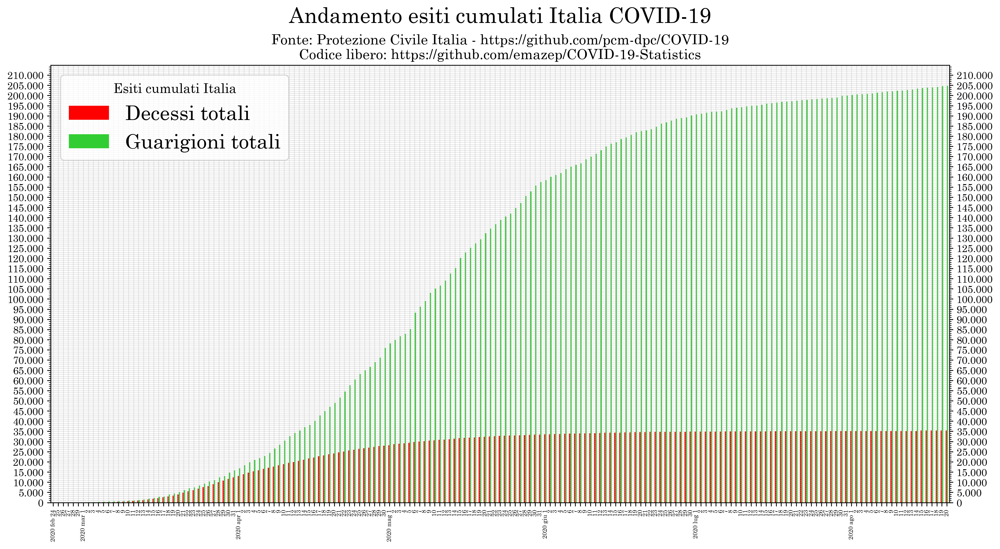

In [16]:
# Exitus trend
ALPHA = 0.3
BAR_WIDTH = 0.3

ax = ds_it.plot.bar(
    y=['deceduti', 'dimessi_guariti'], label=['Decessi totali', 'Guarigioni totali'],
    color=['r', 'limegreen'], figsize=(16,8)
)

ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates_from_numbers(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE, rotation=90)

ax.yaxis.set_major_locator(ticker.MultipleLocator(5_000))
ax.yaxis.set_minor_locator(ticker.MultipleLocator(1_000))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=10)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

ax.legend(title="Esiti cumulati Italia", fontsize=20)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('     Andamento esiti cumulati Italia COVID-19', fontsize=21)

fig_exitus = plt.gcf()

plt.show()

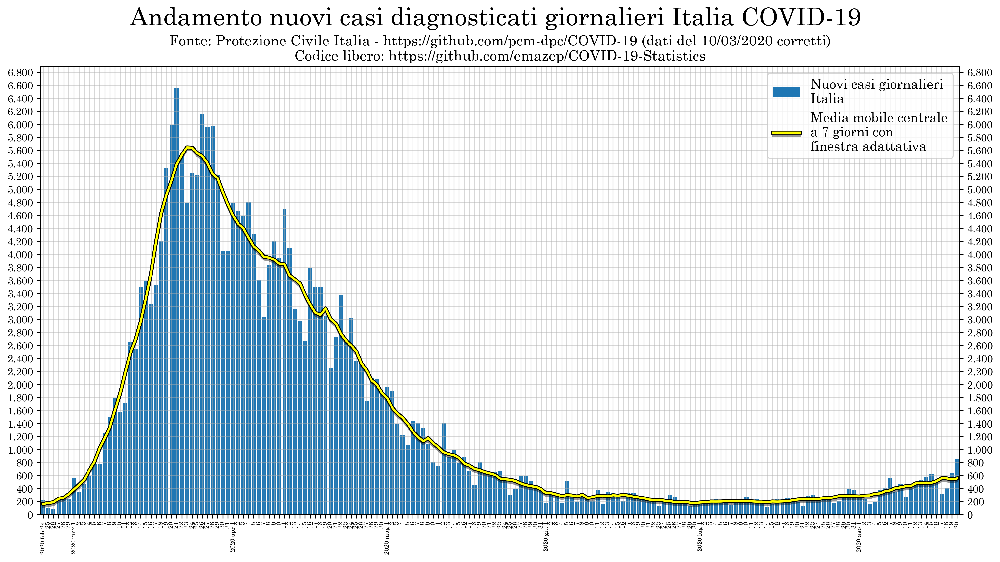

In [17]:
ALPHA = 0.5
LINE_COLOR = 'yellow'
BORDER_COLOR = 'black'
BAR_COLOR = 'tab:blue'
SLACK = GLOBAL_SLACK

_, ax = plt.subplots(figsize=(16,8))

ax.bar(ds_it.index, ds_it['totale_casi_DELTA'], label='Nuovi casi giornalieri\nItalia', color=BAR_COLOR, zorder=1)
ax.plot(
    ds_it.index, ds_it['totale_casi_DELTA_RA_7'], label='Media mobile centrale\na 7 giorni con\nfinestra adattativa',
    zorder=4, **ma_format
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE, rotation=90)

ax.yaxis.set_major_locator(ticker.MultipleLocator(200))
ax.yaxis.set_major_formatter(ticker.ScalarFormatter())
ax.tick_params(axis='y', which='both', labelsize=10)
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))

ax.grid(which='major', alpha=ALPHA)

ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

ax.set_title(SUBTITLE, fontsize=14)
plt.suptitle('   Andamento nuovi casi diagnosticati giornalieri Italia COVID-19', fontsize=24)

#handles, labels = ax.get_legend_handles_labels()
# sort both labels and handles by labels
#labels, handles = zip(*sorted(zip(labels, handles), key=lambda t: t[0]))
#ax.legend(handles, labels, title="Tamponi giornalieri Italia", fontsize=24)

handles, labels = ax.get_legend_handles_labels()
ax.legend(reversed(handles), reversed(labels), fontsize=13, loc='best')

fig_daily_incr = plt.gcf()

plt.show()

In [18]:
ds_reg = reg_data_load()

ds_reg.tail(21)
ds_reg.loc[ds_reg['denominazione_regione']=='Abruzzo'].tail(4)

,stato,codice_regione,denominazione_regione,lat,long,ricoverati_con_sintomi,terapia_intensiva,totale_ospedalizzati,isolamento_domiciliare,totale_positivi,variazione_totale_positivi,nuovi_positivi,dimessi_guariti,deceduti,casi_da_sospetto_diagnostico,casi_da_screening,totale_casi,tamponi,casi_testati,note
data,,,,,,,,,,,,,,,,,,,,
2020-08-17,ITA,13,Abruzzo,42.351222,13.398438,27,1,28,227,255,1,5,2838,472,3200.0,365.0,3565,141205,91479.0,NaN
2020-08-18,ITA,13,Abruzzo,42.351222,13.398438,27,1,28,230,258,3,5,2840,472,3205.0,365.0,3570,141741,91835.0,NaN
2020-08-19,ITA,13,Abruzzo,42.351222,13.398438,25,2,27,238,265,7,7,2840,472,3206.0,371.0,3577,143041,92656.0,NaN
2020-08-20,ITA,13,Abruzzo,42.351222,13.398438,27,1,28,240,268,3,4,2841,472,3206.0,375.0,3581,144159,93423.0,NaN


In [19]:
### REGIONAL DATA RESHAPING ###
ds_regions_sided = regional_data_reshaping(ds_reg)

ds_regions_sided.loc[:, [
    'casi_testati_DELTA_Lombardia', 'positive_test_diagnostici_RATIO_100_Lombardia', 'nuovi_positivi_Lombardia',
    'dimessi_guariti_DELTA_Lombardia', 'deceduti_DELTA_Lombardia', 'variazione_totale_positivi_Lombardia',
    'casi_da_screening_DELTA_Lombardia', 'casi_testati_Liguria'
]].tail(15)

,casi_testati_DELTA_Lombardia,positive_test_diagnostici_RATIO_100_Lombardia,nuovi_positivi_Lombardia,dimessi_guariti_DELTA_Lombardia,deceduti_DELTA_Lombardia,variazione_totale_positivi_Lombardia,casi_da_screening_DELTA_Lombardia,casi_testati_Liguria
data,,,,,,,,
2020-08-06,5432.0,2.17,118,208.0,5.0,-95,45.0,105218.0
2020-08-07,4473.0,1.54,69,152.0,0.0,-83,32.0,105914.0
2020-08-08,3728.0,2.04,76,171.0,3.0,-98,30.0,105987.0
2020-08-09,3553.0,2.00,71,29.0,1.0,41,26.0,107771.0
2020-08-10,1601.0,1.94,31,72.0,0.0,-41,8.0,108164.0
2020-08-11,2775.0,2.45,68,101.0,0.0,-33,25.0,108894.0
2020-08-12,4320.0,2.36,102,95.0,0.0,7,33.0,109799.0
2020-08-13,3823.0,1.94,74,54.0,2.0,18,36.0,110755.0
2020-08-14,4023.0,2.41,97,258.0,1.0,-162,36.0,111663.0


In [20]:
ds_regions_sided.loc[:, [
    'nuovi_positivi_Marche', 'nuovi_positivi_Campania', 'nuovi_positivi_Lazio',
    'nuovi_positivi_Toscana', 'nuovi_positivi_Emilia-Romagna', 'nuovi_positivi_Piemonte',
    'nuovi_positivi_Veneto', 'nuovi_positivi_Sardegna', "nuovi_positivi_Valle d'Aosta", "nuovi_positivi_Sicilia",
    "nuovi_positivi_Molise", "nuovi_positivi_Basilicata", "nuovi_positivi_Umbria", 'nuovi_positivi_Calabria',
    'nuovi_positivi_Puglia', 'nuovi_positivi_P.A. Trento', 'nuovi_positivi_Abruzzo', 'nuovi_positivi_P.A. Bolzano',
    'nuovi_positivi_Liguria', 'nuovi_positivi_Friuli Venezia Giulia'
]].tail(10)

,nuovi_positivi_Marche,nuovi_positivi_Campania,nuovi_positivi_Lazio,nuovi_positivi_Toscana,nuovi_positivi_Emilia-Romagna,nuovi_positivi_Piemonte,nuovi_positivi_Veneto,nuovi_positivi_Sardegna,nuovi_positivi_Valle d'Aosta,nuovi_positivi_Sicilia,nuovi_positivi_Molise,nuovi_positivi_Basilicata,nuovi_positivi_Umbria,nuovi_positivi_Calabria,nuovi_positivi_Puglia,nuovi_positivi_P.A. Trento,nuovi_positivi_Abruzzo,nuovi_positivi_P.A. Bolzano,nuovi_positivi_Liguria,nuovi_positivi_Friuli Venezia Giulia
data,,,,,,,,,,,,,,,,,,,,
2020-08-11,4,23,23,22,19,26,65,20,0,89,0,1,1,11,20,2,3,1,11,3
2020-08-12,16,29,37,33,41,42,60,1,0,29,0,0,6,4,33,0,9,4,26,9
2020-08-13,11,27,36,28,37,26,84,17,0,42,6,1,7,12,16,2,16,3,63,15
2020-08-14,32,44,45,26,57,15,127,5,0,36,0,4,8,19,12,3,13,3,20,8
2020-08-15,11,18,58,38,71,47,120,5,0,46,2,4,13,10,22,0,13,9,33,15
2020-08-16,5,46,68,34,51,40,78,5,0,39,0,0,3,3,15,0,2,9,12,8
2020-08-17,8,34,51,21,41,16,46,7,1,14,0,0,1,4,4,1,5,2,16,5
2020-08-18,15,35,43,31,21,27,60,12,0,13,9,8,10,5,20,2,5,0,27,10
2020-08-19,7,56,75,40,76,42,59,37,2,45,7,1,4,10,33,2,7,7,30,11


In [21]:
ds_regions_sided.loc[:, [
    'terapia_intensiva_DELTA_Marche', 'terapia_intensiva_DELTA_Campania', 'terapia_intensiva_DELTA_Lazio',
    'terapia_intensiva_DELTA_Toscana', 'terapia_intensiva_DELTA_Emilia-Romagna', 'terapia_intensiva_DELTA_Piemonte',
    'terapia_intensiva_DELTA_Veneto', 'terapia_intensiva_DELTA_Sardegna', "terapia_intensiva_DELTA_Valle d'Aosta", "terapia_intensiva_DELTA_Sicilia",
    "terapia_intensiva_DELTA_Molise", "terapia_intensiva_DELTA_Basilicata", "terapia_intensiva_DELTA_Umbria", 'terapia_intensiva_DELTA_Calabria',
    'terapia_intensiva_DELTA_Puglia', 'terapia_intensiva_DELTA_P.A. Trento', 'terapia_intensiva_DELTA_Abruzzo', 'terapia_intensiva_DELTA_P.A. Bolzano',
    'terapia_intensiva_DELTA_Liguria', 'terapia_intensiva_DELTA_Friuli Venezia Giulia'
]].tail(10)

,terapia_intensiva_DELTA_Marche,terapia_intensiva_DELTA_Campania,terapia_intensiva_DELTA_Lazio,terapia_intensiva_DELTA_Toscana,terapia_intensiva_DELTA_Emilia-Romagna,terapia_intensiva_DELTA_Piemonte,terapia_intensiva_DELTA_Veneto,terapia_intensiva_DELTA_Sardegna,terapia_intensiva_DELTA_Valle d'Aosta,terapia_intensiva_DELTA_Sicilia,terapia_intensiva_DELTA_Molise,terapia_intensiva_DELTA_Basilicata,terapia_intensiva_DELTA_Umbria,terapia_intensiva_DELTA_Calabria,terapia_intensiva_DELTA_Puglia,terapia_intensiva_DELTA_P.A. Trento,terapia_intensiva_DELTA_Abruzzo,terapia_intensiva_DELTA_P.A. Bolzano,terapia_intensiva_DELTA_Liguria,terapia_intensiva_DELTA_Friuli Venezia Giulia
data,,,,,,,,,,,,,,,,,,,,
2020-08-11,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2020-08-12,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0
2020-08-13,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2020-08-14,1.0,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1.0,0.0,0.0,0.0,1.0,0.0
2020-08-15,0.0,0.0,0.0,1.0,0.0,0.0,-2.0,0.0,0.0,-1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2020-08-16,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2020-08-17,0.0,0.0,0.0,0.0,0.0,-1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
2020-08-18,0.0,1.0,-3.0,0.0,0.0,1.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,-2.0,0.0
2020-08-19,0.0,0.0,0.0,1.0,3.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [22]:
ds_regions_sided.loc[:, [
    'casi_da_screening_DELTA_Marche', 'casi_da_screening_DELTA_Campania', 'casi_da_screening_DELTA_Lazio',
    'casi_da_screening_DELTA_Toscana', 'casi_da_screening_DELTA_Emilia-Romagna', 'casi_da_screening_DELTA_Piemonte',
    'casi_da_screening_DELTA_Veneto', 'casi_da_screening_DELTA_Sardegna', "casi_da_screening_DELTA_Valle d'Aosta", "casi_da_screening_DELTA_Sicilia",
    "casi_da_screening_DELTA_Molise", "casi_da_screening_DELTA_Basilicata", "casi_da_screening_DELTA_Umbria", 'casi_da_screening_DELTA_Calabria',
    'casi_da_screening_DELTA_Puglia', 'casi_da_screening_DELTA_P.A. Trento', 'casi_da_screening_DELTA_Abruzzo', 'casi_da_screening_DELTA_P.A. Bolzano',
    'casi_da_screening_DELTA_Liguria', 'casi_da_screening_DELTA_Friuli Venezia Giulia'
]].tail(10)

,casi_da_screening_DELTA_Marche,casi_da_screening_DELTA_Campania,casi_da_screening_DELTA_Lazio,casi_da_screening_DELTA_Toscana,casi_da_screening_DELTA_Emilia-Romagna,casi_da_screening_DELTA_Piemonte,casi_da_screening_DELTA_Veneto,casi_da_screening_DELTA_Sardegna,casi_da_screening_DELTA_Valle d'Aosta,casi_da_screening_DELTA_Sicilia,casi_da_screening_DELTA_Molise,casi_da_screening_DELTA_Basilicata,casi_da_screening_DELTA_Umbria,casi_da_screening_DELTA_Calabria,casi_da_screening_DELTA_Puglia,casi_da_screening_DELTA_P.A. Trento,casi_da_screening_DELTA_Abruzzo,casi_da_screening_DELTA_P.A. Bolzano,casi_da_screening_DELTA_Liguria,casi_da_screening_DELTA_Friuli Venezia Giulia
data,,,,,,,,,,,,,,,,,,,,
2020-08-11,0.0,0.0,19.0,2.0,6.0,59.0,47.0,18.0,0.0,72.0,0.0,1.0,0.0,11.0,15.0,2.0,12.0,0.0,4.0,1.0
2020-08-12,0.0,0.0,25.0,28.0,23.0,96.0,42.0,1.0,0.0,17.0,0.0,0.0,5.0,4.0,20.0,0.0,4.0,0.0,7.0,1.0
2020-08-13,0.0,1.0,22.0,23.0,20.0,60.0,51.0,15.0,0.0,25.0,6.0,1.0,2.0,12.0,14.0,1.0,8.0,0.0,2.0,9.0
2020-08-14,0.0,2.0,39.0,21.0,27.0,10.0,100.0,3.0,0.0,28.0,0.0,4.0,5.0,19.0,15.0,2.0,1.0,0.0,1.0,0.0
2020-08-15,0.0,0.0,46.0,31.0,40.0,112.0,86.0,5.0,0.0,31.0,0.0,4.0,10.0,10.0,13.0,0.0,3.0,0.0,10.0,2.0
2020-08-16,0.0,5.0,56.0,24.0,31.0,54.0,58.0,3.0,0.0,32.0,0.0,-1.0,2.0,3.0,12.0,0.0,3.0,0.0,7.0,0.0
2020-08-17,0.0,20.0,45.0,16.0,18.0,18.0,40.0,4.0,0.0,9.0,0.0,0.0,1.0,4.0,1.0,0.0,0.0,0.0,7.0,2.0
2020-08-18,0.0,12.0,37.0,16.0,13.0,45.0,43.0,7.0,0.0,7.0,0.0,6.0,2.0,5.0,17.0,1.0,0.0,0.0,12.0,5.0
2020-08-19,0.0,2.0,59.0,29.0,47.0,71.0,30.0,29.0,0.0,33.0,0.0,1.0,2.0,10.0,17.0,2.0,6.0,0.0,24.0,5.0


In [23]:
ds_regions_sided.loc[:, [
    'casi_da_sospetto_diagnostico_DELTA_Marche', 'casi_da_sospetto_diagnostico_DELTA_Campania', 'casi_da_sospetto_diagnostico_DELTA_Lazio',
    'casi_da_sospetto_diagnostico_DELTA_Toscana', 'casi_da_sospetto_diagnostico_DELTA_Emilia-Romagna', 'casi_da_sospetto_diagnostico_DELTA_Piemonte',
    'casi_da_sospetto_diagnostico_DELTA_Veneto', 'casi_da_sospetto_diagnostico_DELTA_Sardegna', "casi_da_sospetto_diagnostico_DELTA_Valle d'Aosta", "casi_da_sospetto_diagnostico_DELTA_Sicilia",
    "casi_da_sospetto_diagnostico_DELTA_Molise", "casi_da_sospetto_diagnostico_DELTA_Basilicata", "casi_da_sospetto_diagnostico_DELTA_Umbria", 'casi_da_sospetto_diagnostico_DELTA_Calabria',
    'casi_da_sospetto_diagnostico_DELTA_Puglia', 'casi_da_sospetto_diagnostico_DELTA_P.A. Trento', 'casi_da_sospetto_diagnostico_DELTA_Abruzzo', 'casi_da_sospetto_diagnostico_DELTA_P.A. Bolzano',
    'casi_da_sospetto_diagnostico_DELTA_Liguria', 'casi_da_sospetto_diagnostico_DELTA_Friuli Venezia Giulia'
]].tail(10)

,casi_da_sospetto_diagnostico_DELTA_Marche,casi_da_sospetto_diagnostico_DELTA_Campania,casi_da_sospetto_diagnostico_DELTA_Lazio,casi_da_sospetto_diagnostico_DELTA_Toscana,casi_da_sospetto_diagnostico_DELTA_Emilia-Romagna,casi_da_sospetto_diagnostico_DELTA_Piemonte,casi_da_sospetto_diagnostico_DELTA_Veneto,casi_da_sospetto_diagnostico_DELTA_Sardegna,casi_da_sospetto_diagnostico_DELTA_Valle d'Aosta,casi_da_sospetto_diagnostico_DELTA_Sicilia,casi_da_sospetto_diagnostico_DELTA_Molise,casi_da_sospetto_diagnostico_DELTA_Basilicata,casi_da_sospetto_diagnostico_DELTA_Umbria,casi_da_sospetto_diagnostico_DELTA_Calabria,casi_da_sospetto_diagnostico_DELTA_Puglia,casi_da_sospetto_diagnostico_DELTA_P.A. Trento,casi_da_sospetto_diagnostico_DELTA_Abruzzo,casi_da_sospetto_diagnostico_DELTA_P.A. Bolzano,casi_da_sospetto_diagnostico_DELTA_Liguria,casi_da_sospetto_diagnostico_DELTA_Friuli Venezia Giulia
data,,,,,,,,,,,,,,,,,,,,
2020-08-11,4.0,23.0,4.0,20.0,13.0,-33.0,18.0,2.0,0.0,17.0,0.0,0.0,1.0,0.0,5.0,0.0,-9.0,1.0,7.0,2.0
2020-08-12,16.0,29.0,12.0,5.0,18.0,-54.0,18.0,0.0,0.0,12.0,0.0,0.0,1.0,0.0,13.0,0.0,0.0,4.0,19.0,8.0
2020-08-13,11.0,26.0,14.0,5.0,17.0,-34.0,33.0,2.0,0.0,17.0,0.0,0.0,5.0,0.0,2.0,1.0,8.0,2.0,61.0,6.0
2020-08-14,32.0,42.0,6.0,5.0,30.0,5.0,27.0,2.0,0.0,8.0,0.0,0.0,3.0,0.0,-3.0,1.0,12.0,3.0,19.0,8.0
2020-08-15,11.0,18.0,12.0,7.0,31.0,-65.0,34.0,0.0,0.0,15.0,2.0,0.0,3.0,0.0,9.0,0.0,10.0,9.0,23.0,13.0
2020-08-16,5.0,41.0,12.0,10.0,20.0,-14.0,20.0,1.0,0.0,7.0,0.0,0.0,1.0,0.0,3.0,0.0,-1.0,9.0,5.0,8.0
2020-08-17,8.0,14.0,6.0,5.0,23.0,-2.0,6.0,3.0,1.0,5.0,0.0,0.0,0.0,0.0,3.0,1.0,5.0,2.0,9.0,3.0
2020-08-18,15.0,23.0,6.0,15.0,8.0,-18.0,17.0,5.0,0.0,6.0,9.0,0.0,8.0,0.0,3.0,1.0,5.0,0.0,15.0,5.0
2020-08-19,7.0,54.0,16.0,11.0,29.0,-29.0,29.0,8.0,2.0,12.0,7.0,0.0,2.0,0.0,16.0,0.0,1.0,7.0,6.0,6.0


In [24]:
ds_regions_sided.loc[:, [
    'totale_ospedalizzati_DELTA_Campania', 'totale_ospedalizzati_DELTA_Lazio',
    'totale_ospedalizzati_DELTA_Toscana', 'totale_ospedalizzati_DELTA_Emilia-Romagna', 'totale_ospedalizzati_DELTA_Piemonte',
    'totale_ospedalizzati_DELTA_Veneto', 'totale_ospedalizzati_DELTA_Sardegna', "totale_ospedalizzati_DELTA_Valle d'Aosta",
    "totale_ospedalizzati_DELTA_Sicilia", "totale_ospedalizzati_DELTA_Molise", "totale_ospedalizzati_DELTA_Basilicata",
    "totale_ospedalizzati_DELTA_Umbria", 'totale_ospedalizzati_DELTA_Calabria', 'totale_ospedalizzati_DELTA_Puglia',
    'totale_ospedalizzati_DELTA_P.A. Trento', 'totale_ospedalizzati_DELTA_P.A. Bolzano', 'totale_ospedalizzati_DELTA_Liguria',
    'totale_ospedalizzati_DELTA_Abruzzo', 'totale_ospedalizzati_DELTA_Marche', 'totale_ospedalizzati_DELTA_Friuli Venezia Giulia'
]].tail(10)

,totale_ospedalizzati_DELTA_Campania,totale_ospedalizzati_DELTA_Lazio,totale_ospedalizzati_DELTA_Toscana,totale_ospedalizzati_DELTA_Emilia-Romagna,totale_ospedalizzati_DELTA_Piemonte,totale_ospedalizzati_DELTA_Veneto,totale_ospedalizzati_DELTA_Sardegna,totale_ospedalizzati_DELTA_Valle d'Aosta,totale_ospedalizzati_DELTA_Sicilia,totale_ospedalizzati_DELTA_Molise,totale_ospedalizzati_DELTA_Basilicata,totale_ospedalizzati_DELTA_Umbria,totale_ospedalizzati_DELTA_Calabria,totale_ospedalizzati_DELTA_Puglia,totale_ospedalizzati_DELTA_P.A. Trento,totale_ospedalizzati_DELTA_P.A. Bolzano,totale_ospedalizzati_DELTA_Liguria,totale_ospedalizzati_DELTA_Abruzzo,totale_ospedalizzati_DELTA_Marche,totale_ospedalizzati_DELTA_Friuli Venezia Giulia
data,,,,,,,,,,,,,,,,,,,,
2020-08-11,11.0,9.0,2.0,-3.0,-2.0,4.0,0.0,0.0,-1.0,0.0,0.0,1.0,0.0,2.0,-2.0,-2.0,-2.0,-1.0,0.0,-2.0
2020-08-12,-1.0,-13.0,-1.0,2.0,-9.0,0.0,0.0,0.0,-1.0,-1.0,0.0,0.0,0.0,6.0,-2.0,0.0,-1.0,0.0,-1.0,-1.0
2020-08-13,-5.0,5.0,-2.0,1.0,1.0,-3.0,2.0,-2.0,-1.0,0.0,0.0,1.0,0.0,3.0,-1.0,2.0,3.0,1.0,-2.0,0.0
2020-08-14,8.0,-3.0,-1.0,-3.0,0.0,3.0,0.0,0.0,4.0,0.0,0.0,0.0,-1.0,-2.0,1.0,0.0,-2.0,-1.0,3.0,-4.0
2020-08-15,-13.0,1.0,-2.0,-1.0,4.0,3.0,0.0,-1.0,0.0,0.0,0.0,0.0,1.0,1.0,-1.0,0.0,0.0,2.0,3.0,-1.0
2020-08-16,9.0,11.0,1.0,-1.0,-1.0,-3.0,0.0,0.0,4.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,2.0,0.0,-1.0,1.0
2020-08-17,4.0,8.0,1.0,0.0,-6.0,2.0,1.0,-1.0,4.0,0.0,0.0,0.0,-1.0,3.0,0.0,1.0,3.0,2.0,0.0,3.0
2020-08-18,3.0,3.0,5.0,-2.0,6.0,7.0,0.0,0.0,0.0,0.0,0.0,-1.0,2.0,5.0,1.0,0.0,1.0,0.0,1.0,-1.0
2020-08-19,2.0,11.0,5.0,12.0,1.0,-3.0,2.0,0.0,1.0,0.0,0.0,1.0,0.0,-1.0,0.0,0.0,-2.0,-1.0,0.0,2.0


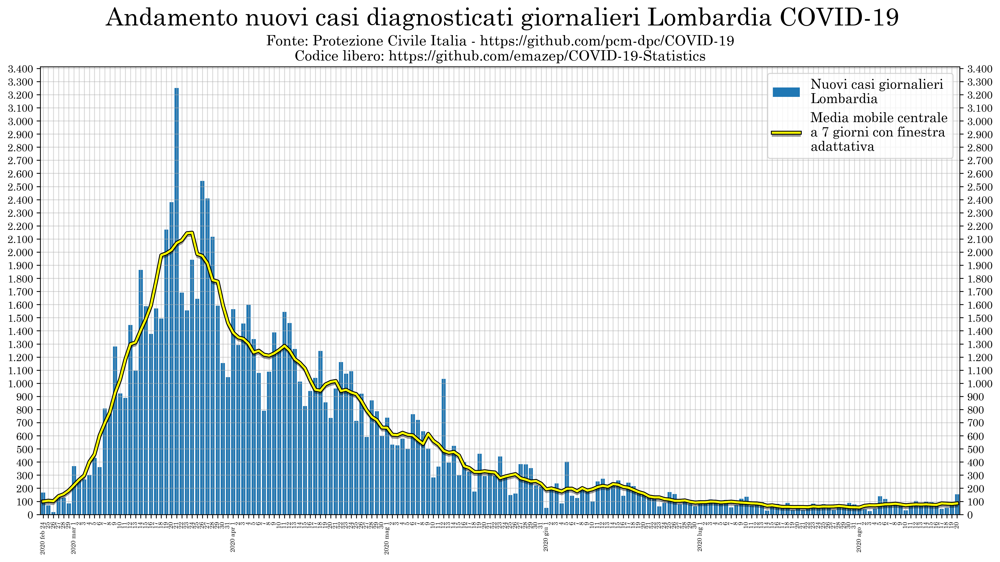

In [25]:
# Daily incr Lombardia

ALPHA = 0.5
LINE_COLOR = 'yellow'
BORDER_COLOR = 'black'
BAR_COLOR = 'tab:blue'
SLACK = GLOBAL_SLACK

REGIONS = ['Lombardia']

_, ax = plt.subplots(figsize=(16,8))

ax.bar(
    ds_regions_sided.index, ds_regions_sided[localize_plot_column(
    'totale_casi_DELTA', REGIONS)[0]], label='Nuovi casi giornalieri\nLombardia', color=BAR_COLOR, zorder=1
)
ax.plot(
    ds_regions_sided.index, ds_regions_sided[localize_plot_column('totale_casi_DELTA_RA_7', REGIONS)[0]],
    label='Media mobile centrale\na 7 giorni con finestra\nadattativa',
    zorder=4, **ma_format
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE, rotation=90)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(100))
ax.yaxis.set_major_formatter(ticker.ScalarFormatter())
ax.tick_params(axis='y', which='both', labelsize=10)
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))

ax.grid(which='major', alpha=ALPHA)

ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('     Andamento nuovi casi diagnosticati giornalieri Lombardia COVID-19', fontsize=24)

handles, labels = ax.get_legend_handles_labels()
ax.legend(reversed(handles), reversed(labels), loc='best', fontsize=13)

fig_daily_incr_regions_Lombardia = plt.gcf()

plt.show()

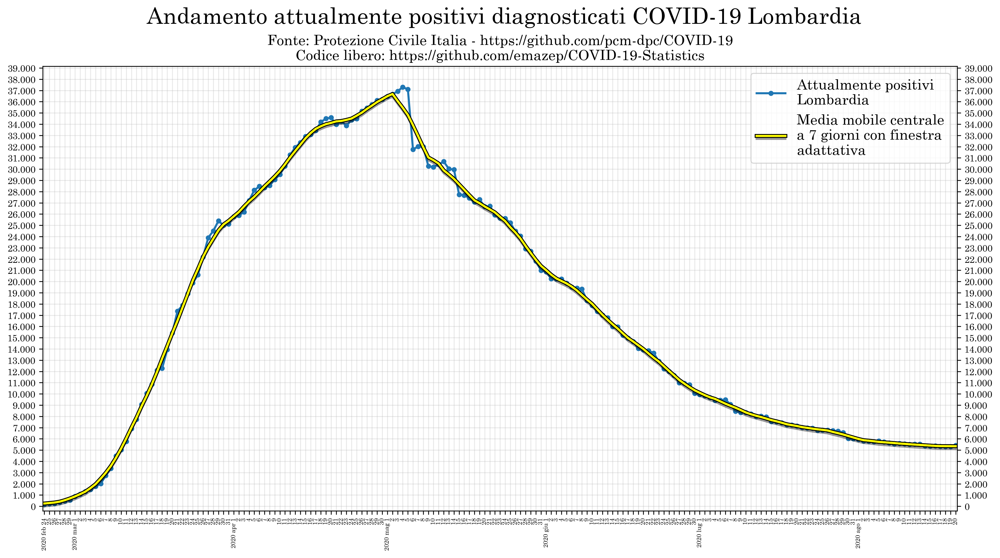

In [26]:
# Lombardia trend
SLACK = 0.3
ALPHA = 0.3

REGIONS = ['Lombardia']
COLUMN = 'totale_positivi'

plot_columns = localize_plot_column(COLUMN, REGIONS)

# Enrich with mean and rolling average
'''
ds_regions_group = make_regions_group_w_ra(plot_columns, days=3)
ax.plot(
    ds_regions_group.index, ds_regions_group['mean_RA'], label='Media mobile centrale a 3 giorni\ndella media delle regioni',
    zorder=4, **ma_format
)
'''
ax = ds_regions_sided.plot(y=plot_columns, label=['Attualmente positivi\nLombardia'], figsize=(16, 8), zorder=2, **small_plt_params)
ax.plot(
    ds_regions_sided.index, ds_regions_sided[localize_plot_column('totale_positivi_RA_7', REGIONS)[0]],
    label='Media mobile centrale\na 7 giorni con finestra\nadattativa',
    zorder=4, **ma_format
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE, rotation=90)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(1_000))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=9)

ax.set_ylim(bottom=-400)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

ax.legend(fontsize=14)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('      Andamento attualmente positivi diagnosticati COVID-19 Lombardia', fontsize=22)

fig_cum_Lombardia = plt.gcf()

plt.show()

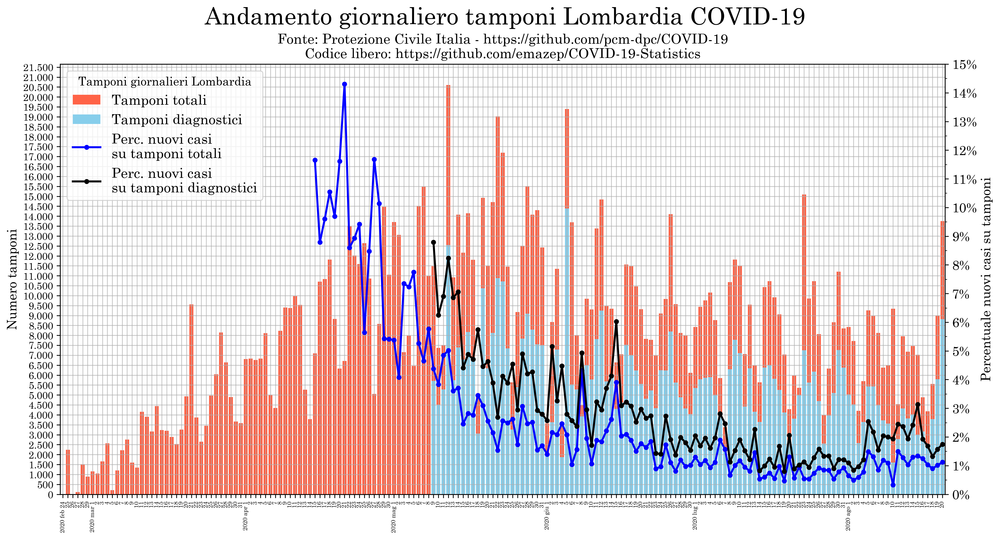

In [27]:
# TAMPONI LOMBARDIA

ALPHA = 0.7
SLACK = GLOBAL_SLACK

PERC_COLOR = 'darkviolet'
NEGATIVE_COLOR = 'limegreen'
POSITIVE_COLOR = 'orange'

REGIONS = ['Lombardia']

# Tests trend
_, ax = plt.subplots(figsize=(16,8))

ax.bar(
    ds_regions_sided.index, ds_regions_sided[localize_plot_column('tamponi_DELTA', REGIONS)[0]],
    label='Tamponi totali', color='tomato'
)
ax.bar(ds_regions_sided.index, ds_regions_sided[localize_plot_column('casi_testati_DELTA_fixed', REGIONS)[0]], label='Tamponi diagnostici', color='skyblue')


'''
ax = ds_regions_sided.plot.bar(
    y=['tamponi_DELTA_Lombardia', 'casi_testati_DELTA_Lombardia'], label=['Decessi totali', 'Guarigioni totali'],
    color=['r', 'limegreen'], figsize=(16,8)
)
'''
ax2 = ax.twinx()
ax2.plot(
    ds_regions_sided.index, ds_regions_sided[localize_plot_column('positive_test_RATIO', REGIONS)[0]],
    label='Perc. nuovi casi\nsu tamponi totali', **small_plt_params, zorder=3, color='blue'
)
ax2.plot(
    ds_regions_sided.index, ds_regions_sided[localize_plot_column('positive_test_diagnostici_RATIO', REGIONS)[0]],
    label='Perc. nuovi casi\nsu tamponi diagnostici', **small_plt_params, zorder=3, color='black'
)

'''
ax2.axhline(
    y=ds_regions_sided[localize_plot_column('positive_test_RATIO', REGIONS)[0]].mean(),
    zorder=0, label='Media perc.\nnuovi casi su tamponi',
    color='skyblue', **small_plt_params, alpha=1,
    xmin=(17/ds_it.index.size)-TAMPONI_MEAN_SLACK
)
'''
set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE, rotation=90)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(500))
ax.yaxis.set_major_formatter(ticker.ScalarFormatter())
ax.tick_params(axis='y', which='both', labelsize=10)
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.set_ylabel('Numero tamponi')

ax.grid(which='major', alpha=ALPHA)

ax.set_ylim(bottom=0)
ax2.set_ylim(bottom=0)

plt.xlabel(None)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('     Andamento giornaliero tamponi Lombardia COVID-19', fontsize=24)

ax2.set_ylabel('Percentuale nuovi casi su tamponi')

ax2.yaxis.set_major_locator(ticker.MultipleLocator(0.01))
ax2.yaxis.set_minor_locator(ticker.MultipleLocator(0.005))
ax2.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x*100:n}'+'%'))

rcParams['font.size'] = 12

# Ask matplotlib for primary y axes labels
handles, labels = ax.get_legend_handles_labels()
# Ask matplotlib for secondary y axes labels
handles2, labels2 = ax2.get_legend_handles_labels()
sep = '\n————————————————'
ax2.legend(
    handles+handles2, labels+labels2,
    title='Tamponi giornalieri Lombardia',
    fontsize=14, loc='upper left'
)

fig_tests_Lombardia = plt.gcf()
plt.show()

rcParams['font.size'] = DEFAULT_FONT_SIZE

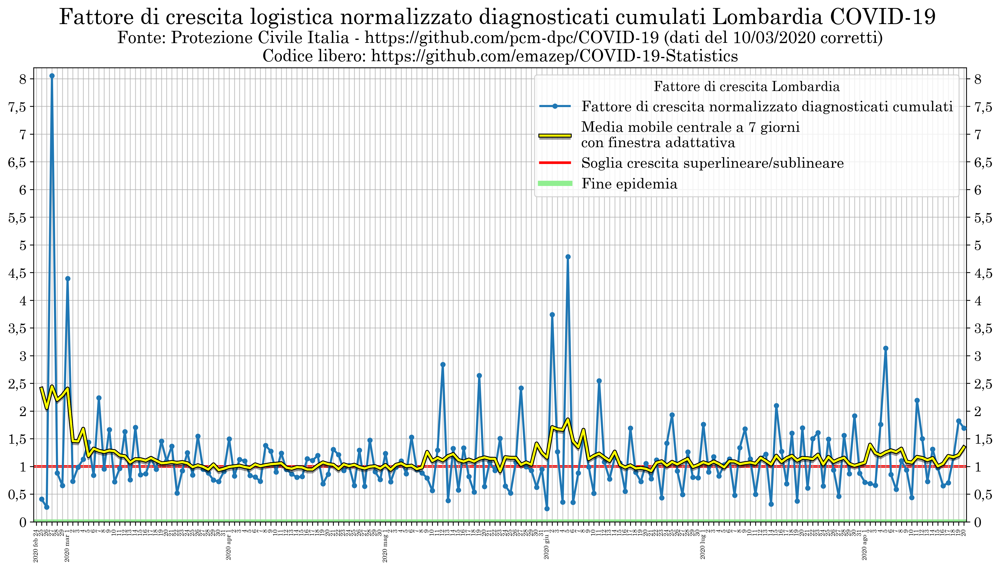

In [28]:
# Growth factor
SLACK = 0.5
ALPHA = 0.7

REGIONS = ['Lombardia']
single_column = localize_plot_column('tamponi_DELTA', REGIONS)[0]

ax = ds_regions_sided.plot(
    y=localize_plot_column('growth_factor_cum_infected', REGIONS)[0], label='Fattore di crescita normalizzato diagnosticati cumulati', **small_plt_params, figsize=(16, 8), zorder=3
)
ax.plot(
    ds_regions_sided.index, ds_regions_sided[localize_plot_column('growth_factor_cum_infected_RA_7', REGIONS)[0]],
    label='Media mobile centrale a 7 giorni\ncon finestra adattativa',
    zorder=4, **ma_format
)
plt.axhline(y=1, color='red', linewidth=2.5, zorder=0, alpha=1, label='Soglia crescita superlineare/sublineare')
plt.axhline(y=0, color='lightgreen', linewidth=5, zorder=0, alpha=1, label='Fine epidemia')

set_xlim(ax, SLACK)

ax.set_ylim(bottom=0)

#ax.xaxis.set_major_locator(mdates.AutoDateLocator())
ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE, rotation=90)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(0.5))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.set_ylim(top=8.2)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

ax.legend(title="Fattore di crescita Lombardia", fontsize=14)

plt.xlabel(None)

ax.set_title(SUBTITLE, fontsize=16)
plt.suptitle('    Fattore di crescita logistica normalizzato diagnosticati cumulati Lombardia COVID-19', fontsize=21)

fig_growth_Lombardia = plt.gcf()

plt.show()

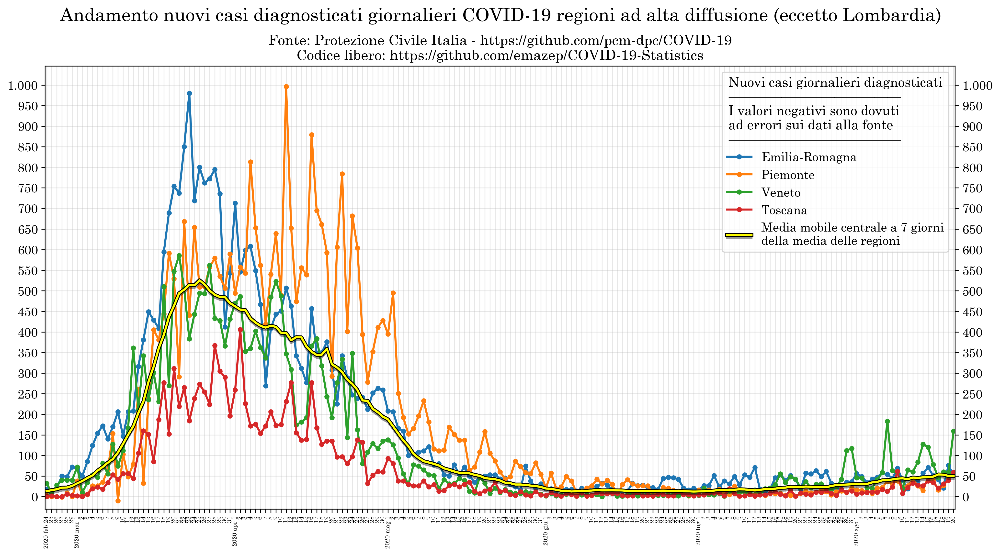

In [29]:
# Highly critical regions trend
SLACK = 0.3
ALPHA = 0.3

REGIONS = ['Emilia-Romagna', 'Piemonte', 'Veneto', 'Toscana']
COLUMN = 'totale_casi_DELTA'

plot_columns = localize_plot_column(COLUMN, REGIONS)

# Enrich with mean and rolling average
ds_regions_group = make_regions_group_w_ra(ds_regions_sided, plot_columns, days=7)

ax = ds_regions_group.plot(y=plot_columns, label=REGIONS, figsize=(16, 8), zorder=2, **small_plt_params)
ax.plot(
    ds_regions_group.index, ds_regions_group['mean_RA'], label='Media mobile centrale a 7 giorni\ndella media delle regioni',
    zorder=4, **ma_format
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE, rotation=90)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(50))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=12)

ax.set_ylim(bottom=-30)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

sep = '\n—————————————'
ax.legend(title='Nuovi casi giornalieri diagnosticati' + sep + '\nI valori negativi sono dovuti\nad errori sui dati alla fonte' + sep, fontsize=12)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('      Andamento nuovi casi diagnosticati giornalieri COVID-19 regioni ad alta diffusione (eccetto Lombardia)', fontsize=18)

fig_daily_incr_regions_high = plt.gcf()

plt.show()

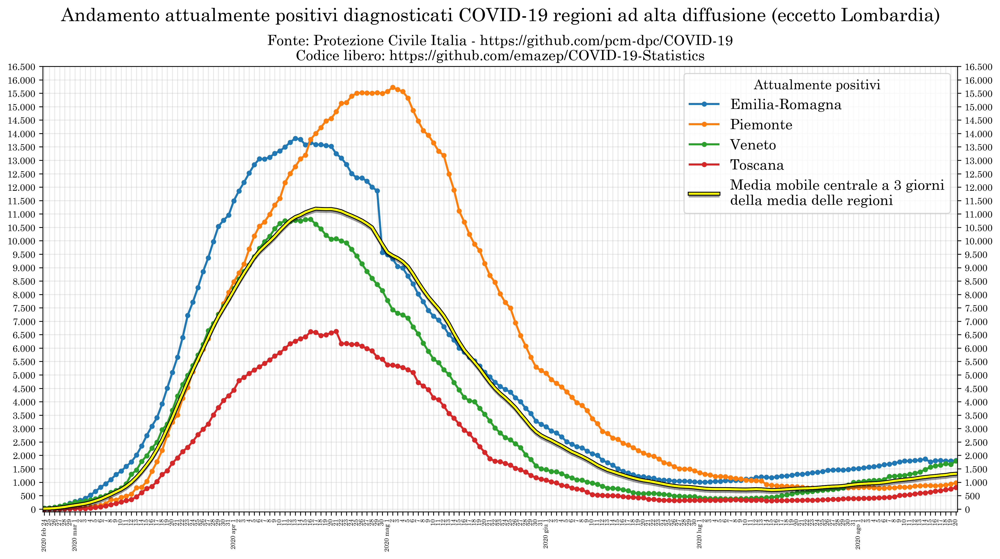

In [30]:
# Highly critical regions trend
SLACK = 0.3
ALPHA = 0.3

REGIONS = ['Emilia-Romagna', 'Piemonte', 'Veneto', 'Toscana']
COLUMN = 'totale_positivi'

plot_columns = localize_plot_column(COLUMN, REGIONS)

# Enrich with mean and rolling average
ds_regions_group = make_regions_group_w_ra(ds_regions_sided, plot_columns, days=3)

ax = ds_regions_sided.plot(y=plot_columns, label=REGIONS, figsize=(16, 8), zorder=2, **small_plt_params)

ax.plot(
    ds_regions_group.index, ds_regions_group['mean_RA'], label='Media mobile centrale a 3 giorni\ndella media delle regioni',
    zorder=4, **ma_format
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE, rotation=90)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(500))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=9)

ax.set_ylim(bottom=-100)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

ax.legend(title='Attualmente positivi', fontsize=14)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('      Andamento attualmente positivi diagnosticati COVID-19 regioni ad alta diffusione (eccetto Lombardia)', fontsize=18)

fig_cum_regions_high = plt.gcf()

plt.show()

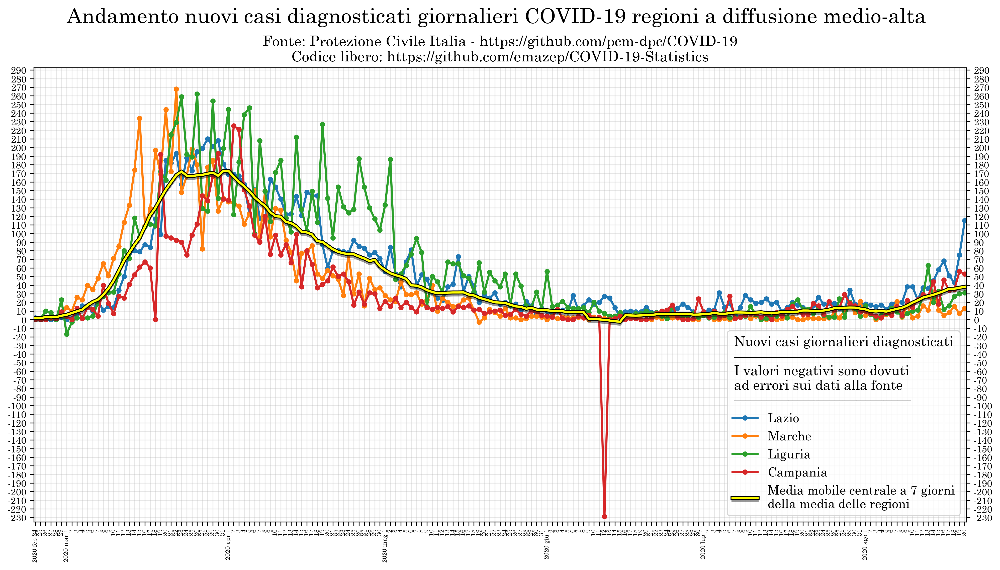

In [31]:
# Medium-high critical regions trend
SLACK = 0.3
ALPHA = 0.3

REGIONS = ['Lazio', 'Marche', 'Liguria', 'Campania']
COLUMN = 'totale_casi_DELTA'

plot_columns = localize_plot_column(COLUMN, REGIONS)

# Enrich with mean and rolling average
ds_regions_group = make_regions_group_w_ra(ds_regions_sided, plot_columns, days=7)

ax = ds_regions_group.plot(y=plot_columns, label=REGIONS, figsize=(16, 8), zorder=2, **small_plt_params)
ax.plot(
    ds_regions_group.index, ds_regions_group['mean_RA'], label='Media mobile centrale a 7 giorni\ndella media delle regioni',
    zorder=4, **ma_format
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE, rotation=90)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(10))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=9)

ax.set_ylim(bottom=-235)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

sep = '\n—————————————'
ax.legend(title='Nuovi casi giornalieri diagnosticati' + sep + '\nI valori negativi sono dovuti\nad errori sui dati alla fonte' + sep, fontsize=12)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('    Andamento nuovi casi diagnosticati giornalieri COVID-19 regioni a diffusione medio-alta', fontsize=20)

fig_daily_incr_regions_medium_high = plt.gcf()

plt.show()

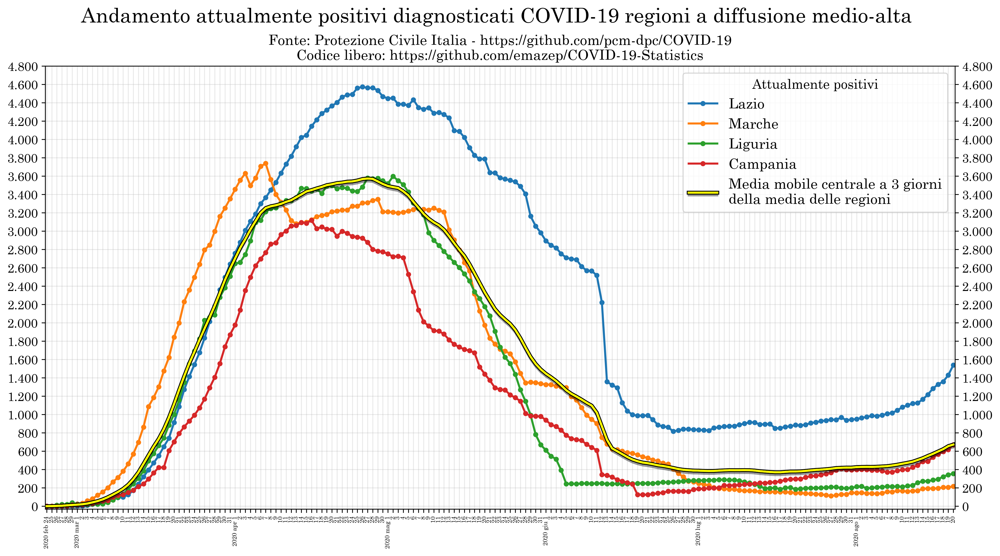

In [32]:
# Medium critical regions trend
SLACK = 0.3
ALPHA = 0.3

REGIONS = ['Lazio', 'Marche', 'Liguria', 'Campania']
COLUMN = 'totale_positivi'

plot_columns = localize_plot_column(COLUMN, REGIONS)

# Enrich with mean and rolling average
ds_regions_group = make_regions_group_w_ra(ds_regions_sided, plot_columns, days=3)

ax = ds_regions_sided.plot(y=plot_columns, label=REGIONS, figsize=(16, 8), zorder=2, **small_plt_params)

ax.plot(
    ds_regions_group.index, ds_regions_group['mean_RA'], label='Media mobile centrale a 3 giorni\ndella media delle regioni',
    zorder=4, **ma_format
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE, rotation=90)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(200))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=12)

ax.set_ylim(bottom=-30)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

ax.legend(title='Attualmente positivi', fontsize=14)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('    Andamento attualmente positivi diagnosticati COVID-19 regioni a diffusione medio-alta', fontsize=20)

fig_cum_regions_medium_high = plt.gcf()

plt.show()

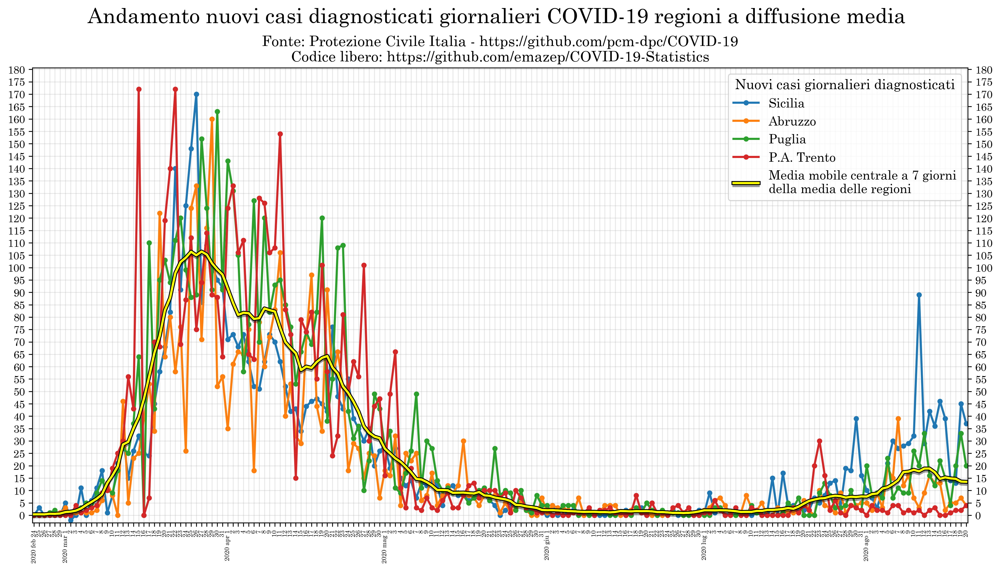

In [33]:
# Moderate critical regions trend
SLACK = 0.3
ALPHA = 0.3

REGIONS = ['Sicilia', 'Abruzzo', 'Puglia', 'P.A. Trento']
COLUMN = 'totale_casi_DELTA'

plot_columns = localize_plot_column(COLUMN, REGIONS)

# Enrich with mean and rolling average
ds_regions_group = make_regions_group_w_ra(ds_regions_sided, plot_columns, days=7)

ax = ds_regions_group.plot(y=plot_columns, label=REGIONS, figsize=(16, 8), zorder=2, **small_plt_params)
ax.plot(
    ds_regions_group.index, ds_regions_group['mean_RA'], label='Media mobile centrale a 7 giorni\ndella media delle regioni',
    zorder=4, **ma_format
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE, rotation=90)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(5))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=10)

ax.set_ylim(bottom=-3)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

ax.legend(title='Nuovi casi giornalieri diagnosticati', fontsize=12)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('    Andamento nuovi casi diagnosticati giornalieri COVID-19 regioni a diffusione media', fontsize=20)

fig_daily_incr_regions_medium = plt.gcf()

plt.show()

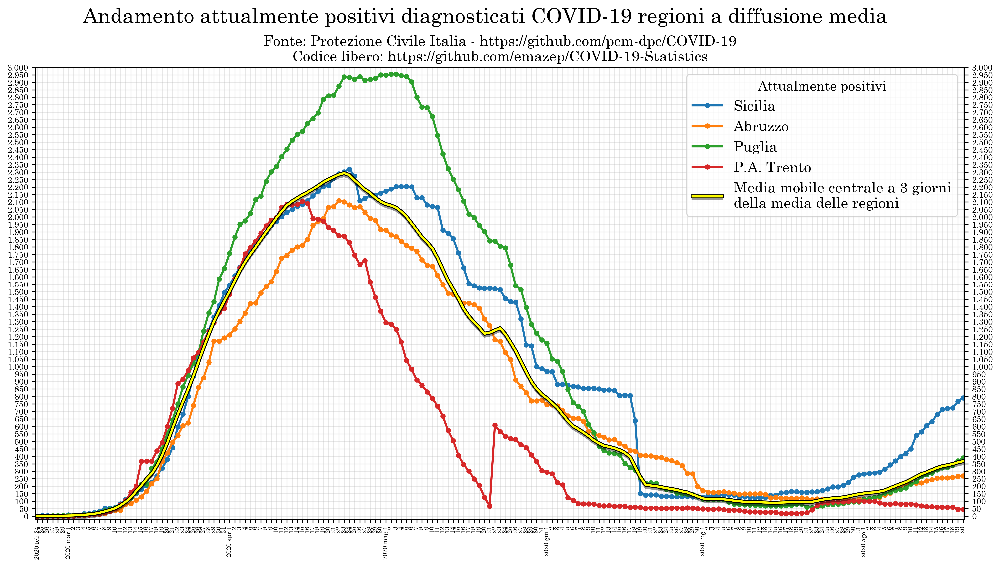

In [34]:
# Moderate critical regions trend
SLACK = 0.3
ALPHA = 0.3

REGIONS = ['Sicilia', 'Abruzzo', 'Puglia', 'P.A. Trento']
COLUMN = 'totale_positivi'

plot_columns = localize_plot_column(COLUMN, REGIONS)

# Enrich with mean and rolling average
ds_regions_group = make_regions_group_w_ra(ds_regions_sided, plot_columns, days=3)

ax = ds_regions_sided.plot(y=plot_columns, label=REGIONS, figsize=(16, 8), zorder=2, **small_plt_params)

ax.plot(
    ds_regions_group.index, ds_regions_group['mean_RA'], label='Media mobile centrale a 3 giorni\ndella media delle regioni',
    zorder=4, **ma_format
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE, rotation=90)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(50))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=8)
ax.set_ylim(bottom=-20, top=3000)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

ax.legend(title='Attualmente positivi', fontsize=14)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('Andamento attualmente positivi diagnosticati COVID-19 regioni a diffusione media', fontsize=20)

fig_cum_regions_medium = plt.gcf()

plt.show()

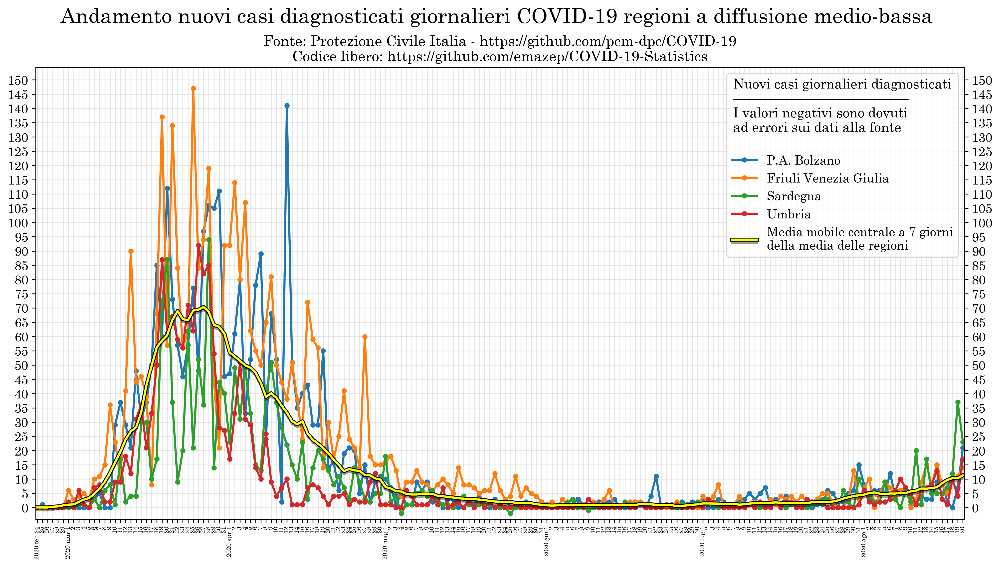

In [35]:
# Moderate critical regions trend
SLACK = 0.3
ALPHA = 0.3

REGIONS = ['P.A. Bolzano', 'Friuli Venezia Giulia', 'Sardegna', 'Umbria']
COLUMN = 'totale_casi_DELTA'

plot_columns = localize_plot_column(COLUMN, REGIONS)

# Enrich with mean and rolling average
ds_regions_group = make_regions_group_w_ra(ds_regions_sided, plot_columns, days=7)

ax = ds_regions_group.plot(y=plot_columns, label=REGIONS, figsize=(16, 8), zorder=2, **small_plt_params)
ax.plot(
    ds_regions_group.index, ds_regions_group['mean_RA'], label='Media mobile centrale a 7 giorni\ndella media delle regioni',
    zorder=4, **ma_format
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE, rotation=90)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(5))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=12)
ax.set_ylim(bottom=-4)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

sep = '\n—————————————'
ax.legend(title='Nuovi casi giornalieri diagnosticati' + sep + '\nI valori negativi sono dovuti\nad errori sui dati alla fonte' + sep, fontsize=12)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('    Andamento nuovi casi diagnosticati giornalieri COVID-19 regioni a diffusione medio-bassa', fontsize=20)

fig_daily_incr_regions_medium_low = plt.gcf()

plt.show()

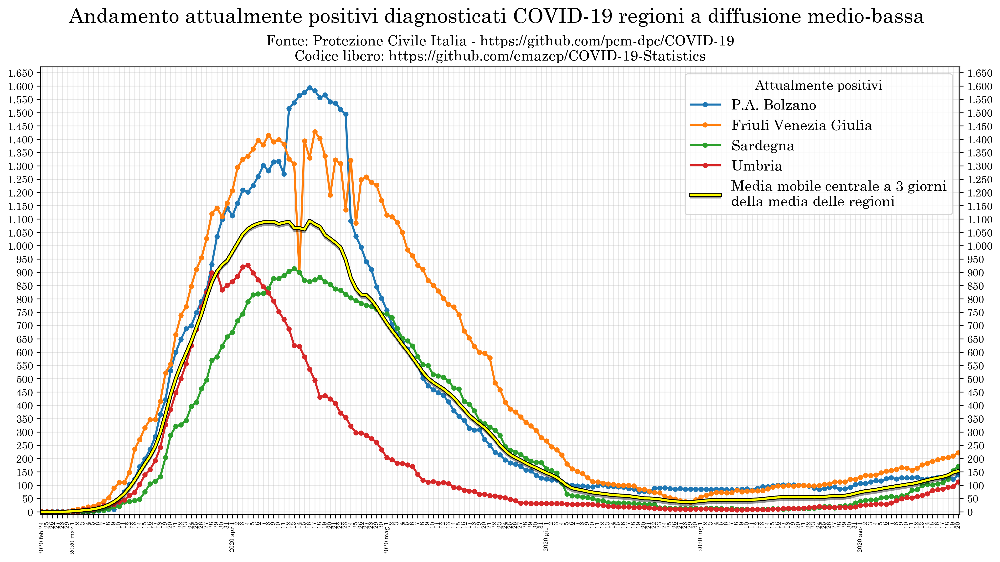

In [36]:
# Moderate critical regions trend
SLACK = 0.3
ALPHA = 0.3

REGIONS = ['P.A. Bolzano', 'Friuli Venezia Giulia', 'Sardegna', 'Umbria']
COLUMN = 'totale_positivi'

plot_columns = localize_plot_column(COLUMN, REGIONS)

# Enrich with mean and rolling average
ds_regions_group = make_regions_group_w_ra(ds_regions_sided, plot_columns, days=3)

ax = ds_regions_sided.plot(y=plot_columns, label=REGIONS, figsize=(16, 8), zorder=2, **small_plt_params)

ax.plot(
    ds_regions_group.index, ds_regions_group['mean_RA'], label='Media mobile centrale a 3 giorni\ndella media delle regioni',
    zorder=4, **ma_format
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE, rotation=90)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(50))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=10)
ax.set_ylim(bottom=-10)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

ax.legend(title='Attualmente positivi', fontsize=14)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('    Andamento attualmente positivi diagnosticati COVID-19 regioni a diffusione medio-bassa', fontsize=20)

fig_cum_regions_medium_low = plt.gcf()

plt.show()

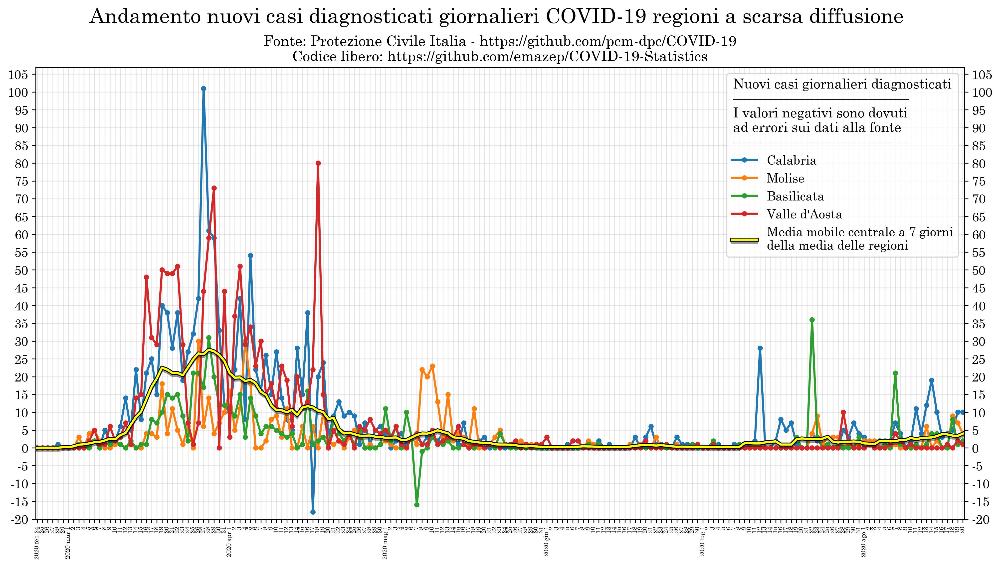

In [37]:
# Low critical regions trend
SLACK = 0.3
ALPHA = 0.3

REGIONS = ['Calabria', 'Molise', 'Basilicata', "Valle d'Aosta"]
COLUMN = 'totale_casi_DELTA'

plot_columns = localize_plot_column(COLUMN, REGIONS)

# Enrich with mean and rolling average
ds_regions_group = make_regions_group_w_ra(ds_regions_sided, plot_columns, days=7)

ax = ds_regions_group.plot(y=plot_columns, label=REGIONS, figsize=(16, 8), zorder=2, **small_plt_params)
ax.plot(
    ds_regions_group.index, ds_regions_group['mean_RA'], label='Media mobile centrale a 7 giorni\ndella media delle regioni',
    zorder=4, **ma_format
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE, rotation=90)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(5))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=12)

ax.set_ylim(bottom=-20)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

sep = '\n—————————————'
ax.legend(title='Nuovi casi giornalieri diagnosticati' + sep + '\nI valori negativi sono dovuti\nad errori sui dati alla fonte' + sep, fontsize=12, loc='best')

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('    Andamento nuovi casi diagnosticati giornalieri COVID-19 regioni a scarsa diffusione', fontsize=20)

fig_daily_incr_regions_low = plt.gcf()

plt.show()

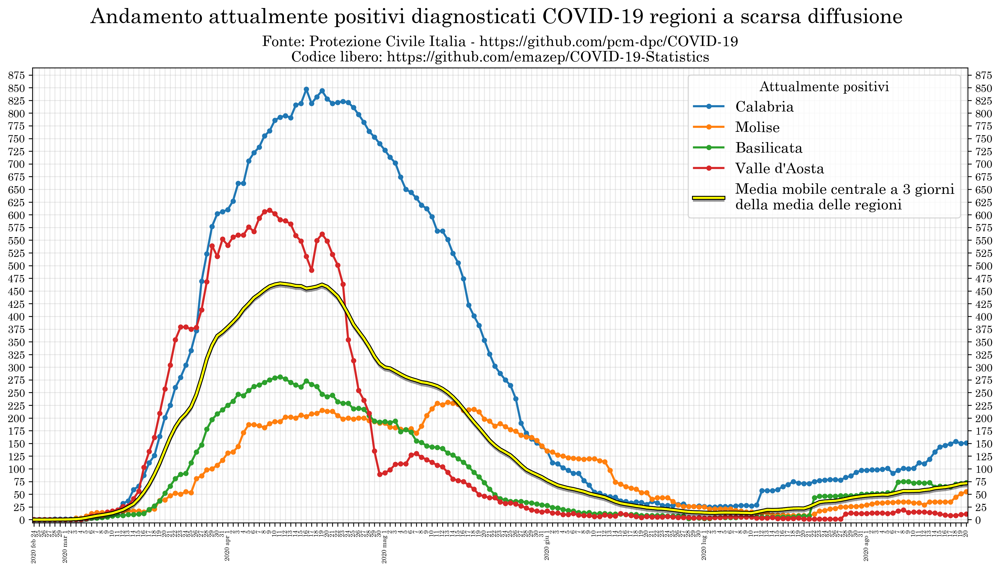

In [38]:
# Low critical regions trend
SLACK = 0.3
ALPHA = 0.3

REGIONS = ['Calabria', 'Molise', 'Basilicata', "Valle d'Aosta"]
COLUMN = 'totale_positivi'

plot_columns = localize_plot_column(COLUMN, REGIONS)

# Enrich with mean and rolling average
ds_regions_group = make_regions_group_w_ra(ds_regions_sided, plot_columns, days=3)

ax = ds_regions_sided.plot(y=plot_columns, label=REGIONS, figsize=(16, 8), zorder=2, **small_plt_params)

ax.plot(
    ds_regions_group.index, ds_regions_group['mean_RA'], label='Media mobile centrale a 3 giorni\ndella media delle regioni',
    zorder=4, **ma_format
)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE, rotation=90)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(25))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=10)

ax.set_ylim(bottom=-6)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

ax.legend(title='Attualmente positivi', fontsize=14, loc='best')

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('    Andamento attualmente positivi diagnosticati COVID-19 regioni a scarsa diffusione', fontsize=20)

fig_cum_regions_low = plt.gcf()

plt.show()

In [39]:
CONTAGIOUS_PERIOD = 23
last_day = ds_it.index.max()
#last_day = date.fromisoformat('2020-03-20')

last_day_2 = last_day - dt.timedelta(days=1)
last_day_3 = last_day - dt.timedelta(days=2)
last_day_4 = last_day - dt.timedelta(days=3)
last_day_7 = last_day - dt.timedelta(days=6)

last_day_11 = last_day - dt.timedelta(days=11)
last_day_9 = last_day - dt.timedelta(days=9)

# Nation-wide
# Tamponi
ds_it_last_3_days = ds_it.loc[last_day_3:, ['totale_casi_DELTA', 'casi_testati_DELTA']].agg('sum')

# Rt
ds_it_7_days_ago_mean = ds_it.loc[last_day_11:last_day_9, ['totale_positivi']].agg('mean')
ds_it_last_7_days_mean = ds_it.loc[last_day_7:, ['totale_casi_DELTA']].agg('mean')
R0_it = ds_it_last_7_days_mean['totale_casi_DELTA'] / ds_it_7_days_ago_mean['totale_positivi'] * CONTAGIOUS_PERIOD

R0_it

0.9545183121019108

In [40]:
# Regions

###

ds_reg_last_day = ds_reg[last_day:].copy()

ds_reg_last_day['CFR'] = ds_reg_last_day['deceduti'] / ds_reg_last_day['totale_casi']
ds_reg_last_day['pop'] = ds_reg_last_day['denominazione_regione'].map(REGIONS_POP)
ds_reg_last_day['infection_density'] = ds_reg_last_day['totale_positivi'] / ds_reg_last_day['pop'] * 10_000
ds_reg_last_day['tamponi_density'] = ds_reg_last_day['tamponi'] / ds_reg_last_day['pop']
ds_reg_last_day['death_density'] = ds_reg_last_day['deceduti'] / ds_reg_last_day['pop']
ds_reg_last_day['icu_density'] = ds_reg_last_day['terapia_intensiva'] / ds_reg_last_day['totale_positivi']
ds_reg_last_day['icu_over_cases'] = ds_reg_last_day['terapia_intensiva'] / ds_reg_last_day['totale_casi']
ds_reg_last_day['recovered_over_cases'] = ds_reg_last_day['dimessi_guariti'] / ds_reg_last_day['totale_casi']
#ds_reg_last_day

# MAX DELTA PERC
ds_reg_last_day['totale_positivi_MAX'] = None
for region_name in ds_reg_last_day['denominazione_regione']:
    max_totale_positivi_value = ds_reg.loc[ds_reg['denominazione_regione']==region_name, ['totale_positivi']].max().values
    ds_reg_last_day.loc[ds_reg_last_day['denominazione_regione']==region_name, 'totale_positivi_MAX'] = max_totale_positivi_value

ds_reg_last_day['totale_positivi_MAX_DELTA_PERC'] = (ds_reg_last_day['totale_positivi_MAX'] - ds_reg_last_day['totale_positivi']) / ds_reg_last_day['totale_positivi_MAX']

###

ds_reg_last_3_days = ds_reg[last_day_3:].groupby('denominazione_regione').agg(
    nuovi_positivi = pd.NamedAgg(column='nuovi_positivi', aggfunc='sum'),
    tamponi = pd.NamedAgg(column='casi_testati', aggfunc='max')
)

# Tamponi
ds_reg_4_days_ago = ds_reg.loc[last_day_4, ['denominazione_regione', 'casi_testati']].groupby('denominazione_regione').agg(tamponi = pd.NamedAgg(column='casi_testati', aggfunc='max'))
ds_reg_last_3_days['tamponi'] -= ds_reg_4_days_ago['tamponi']
ds_reg_last_3_days['test_RATIO'] = ds_reg_last_3_days['nuovi_positivi'] / ds_reg_last_3_days['tamponi']
# Needed for the graph
ds_reg_last_3_days['denominazione_regione'] = ds_reg_last_3_days.index

# R0
ds_reg_R0 = ds_reg[last_day_11:last_day_9].groupby('denominazione_regione').agg(
    totale_positivi = pd.NamedAgg(column='totale_positivi', aggfunc='mean')
)
ds_reg_last_7_days = ds_reg[last_day_7:].groupby('denominazione_regione').agg(
    nuovi_positivi_mean = pd.NamedAgg(column='nuovi_positivi', aggfunc='mean')
)
ds_reg_R0['R0'] = ds_reg_last_7_days['nuovi_positivi_mean'] / ds_reg_R0['totale_positivi'] * CONTAGIOUS_PERIOD
ds_reg_R0['denominazione_regione'] = ds_reg_R0.index

ds_reg_R0

# Scatter
ds_reg_last_day.sort_values(by='tamponi_density')


,stato,codice_regione,denominazione_regione,lat,long,ricoverati_con_sintomi,terapia_intensiva,totale_ospedalizzati,isolamento_domiciliare,totale_positivi,...,CFR,pop,infection_density,tamponi_density,death_density,icu_density,icu_over_cases,recovered_over_cases,totale_positivi_MAX,totale_positivi_MAX_DELTA_PERC
data,,,,,,,,,,,,,,,,,,,,,
2020-08-20,ITA,19,Sicilia,38.115697,13.362357,41,8,49,741,790,...,0.073806,4999891,1.580034,0.063772,0.000057,0.010127,0.002065,0.722323,2320,0.659483
2020-08-20,ITA,15,Campania,40.839566,14.250850,56,2,58,613,671,...,0.080645,5801692,1.156559,0.064052,0.000076,0.002981,0.000367,0.796371,3118,0.784798
2020-08-20,ITA,16,Puglia,41.125596,16.867367,58,3,61,328,389,...,0.112462,4029053,0.965487,0.068580,0.000138,0.007712,0.000608,0.808713,2955,0.868359
2020-08-20,ITA,18,Calabria,38.905976,16.594402,11,1,12,139,151,...,0.070443,1947131,0.775500,0.072438,0.000050,0.006623,0.000726,0.819898,847,0.821724
2020-08-20,ITA,20,Sardegna,39.215312,9.110616,12,0,12,159,171,...,0.085514,1639591,1.042943,0.074014,0.000082,0.000000,0.000000,0.805361,914,0.81291
2020-08-20,ITA,12,Lazio,41.892770,12.483667,238,6,244,1296,1540,...,0.092658,5879082,2.619457,0.080607,0.000148,0.003896,0.000638,0.743704,4573,0.663241
2020-08-20,ITA,17,Basilicata,40.639471,15.805148,0,0,0,73,73,...,0.056680,562869,1.296927,0.092309,0.000050,0.000000,0.000000,0.795547,281,0.740214
2020-08-20,ITA,14,Molise,41.557748,14.659161,1,0,1,54,55,...,0.045365,305617,1.799638,0.100377,0.000075,0.000000,0.000000,0.846154,231,0.761905
2020-08-20,ITA,13,Abruzzo,42.351222,13.398438,27,1,28,240,268,...,0.131807,1311580,2.043337,0.109912,0.000360,0.003731,0.000279,0.793354,2108,0.872865


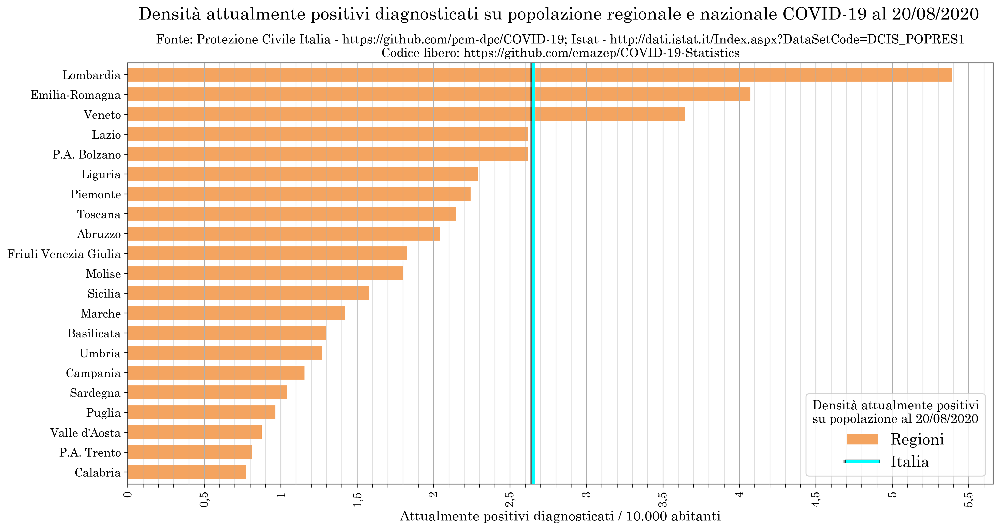

In [41]:
# Infected over pop
ALPHA = 0.7
BAR_WIDTH = 0.3
pe_shadow_lateral = pe.SimpleLineShadow(offset=(-2,0), alpha=0.4)

last_date_str = ds_reg_last_day.index.max().strftime('%d/%m/%Y')
ds_reg_last_day_sorted = ds_reg_last_day.sort_values(by='infection_density')

x='denominazione_regione'
y='infection_density'

ax = ds_reg_last_day_sorted.plot.barh(
    x, y, figsize=(16,8), color='sandybrown', label='Regioni', zorder=0, width=0.7
)

ax.xaxis.set_major_locator(ticker.MultipleLocator(0.5))
ax.xaxis.set_minor_locator(ticker.MultipleLocator(0.1))
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='x', which='both', labelsize=12)
plt.xticks(rotation=90)
ax.xaxis.grid(which='major', alpha=1)
ax.xaxis.grid(which='minor', alpha=0.4)
plt.xlabel('Attualmente positivi diagnosticati / 10.000 abitanti', fontsize=14)

ax.tick_params(axis='y', which='both', labelsize=12)
plt.ylabel(None)

last_index = ds_it.index.max()
infection_density_Italy = ds_it.loc[last_index, 'totale_positivi'] / 60_359_546 * 10_000
plt.axvline(x=infection_density_Italy, zorder=3, color='cyan', linewidth=3, path_effects=[pe_outline, pe_shadow_lateral, pe_normal], label='Italia')

handles, labels = ax.get_legend_handles_labels()
ax.legend(reversed(handles), reversed(labels), title='Densità attualmente positivi\nsu popolazione al '+last_date_str, fontsize=16)

ax.set_title(SUBTITLE_NO_CORR_ISTAT, fontsize=13)
plt.suptitle('     Densità attualmente positivi diagnosticati su popolazione regionale e nazionale COVID-19 al '+last_date_str, fontsize=18)

fig_density = plt.gcf()

plt.show()

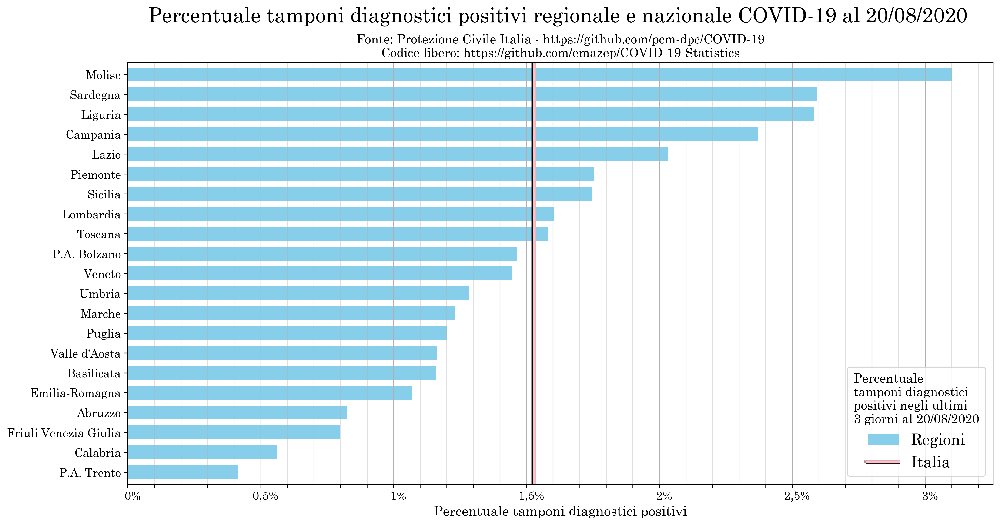

In [42]:
# Test RATIO
ALPHA = 0.7
BAR_WIDTH = 0.3
pe_shadow_lateral = pe.SimpleLineShadow(offset=(-2,0), alpha=0.4)

last_date_str = ds_reg_last_day.index.max().strftime('%d/%m/%Y')
ds_reg_last_3_days_sorted = ds_reg_last_3_days.sort_values(by='test_RATIO')

x='denominazione_regione'
y='test_RATIO'

ax = ds_reg_last_3_days_sorted.plot.barh(
    x, y, figsize=(16,8), color='skyblue', label='Regioni', zorder=0, width=0.7
)

ax.xaxis.set_major_locator(ticker.MultipleLocator(0.005))
ax.xaxis.set_minor_locator(ticker.MultipleLocator(0.001))
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'   {x*100:n}'+'%'))
ax.tick_params(axis='x', which='both', labelsize=12)
#plt.xticks(rotation=90)
ax.xaxis.grid(which='major', alpha=1)
ax.xaxis.grid(which='minor', alpha=0.4)
plt.xlabel('Percentuale tamponi diagnostici positivi', fontsize=14)

ax.tick_params(axis='y', which='both', labelsize=12)
plt.ylabel(None)

ax.set_xlim(left=0)

last_index = ds_it.index.max()
perc_Italy =  ds_it_last_3_days['totale_casi_DELTA'] / ds_it_last_3_days['casi_testati_DELTA']
plt.axvline(x=perc_Italy, zorder=3, color='pink', linewidth=3, path_effects=[pe_outline, pe_shadow_lateral, pe_normal], label='Italia')

handles, labels = ax.get_legend_handles_labels()
ax.legend(reversed(handles), reversed(labels), title='Percentuale \ntamponi diagnostici\npositivi negli ultimi\n3 giorni al '+last_date_str, fontsize=16, loc="lower right")

ax.set_title(SUBTITLE_NO_CORR, fontsize=13)
plt.suptitle('    Percentuale tamponi diagnostici positivi regionale e nazionale COVID-19 al '+last_date_str, fontsize=21)

fig_regional_test_RATIO = plt.gcf()

plt.show()

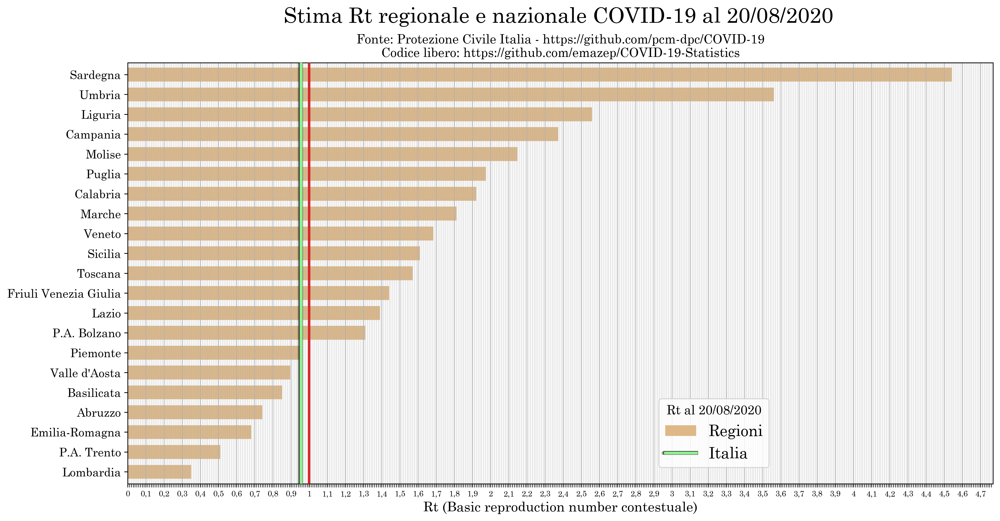

In [43]:
# R₀
ALPHA = 0.7
BAR_WIDTH = 0.3
pe_shadow_lateral = pe.SimpleLineShadow(offset=(-2,0), alpha=0.4)

last_date_str = ds_reg_last_day.index.max().strftime('%d/%m/%Y')
ds_reg_R0_sorted = ds_reg_R0.sort_values(by='R0')

ds_reg_R0_sorted_tmp = ds_reg_R0_sorted[
    (ds_reg_R0_sorted.denominazione_regione != "Valle d'Aosta") &
    (ds_reg_R0_sorted.denominazione_regione != "Sardegna")
]

x='denominazione_regione'
y='R0'

ax = ds_reg_R0_sorted.plot.barh(
    x, y, figsize=(16,8), color='burlywood', label='Regioni', zorder=0, width=0.7
)

ax.xaxis.set_major_locator(ticker.MultipleLocator(0.1))
ax.xaxis.set_minor_locator(ticker.MultipleLocator(0.01))
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='x', which='both', labelsize=8)
#plt.xticks(rotation=90)
ax.xaxis.grid(which='major', alpha=1)
ax.xaxis.grid(which='minor', alpha=0.4)
plt.xlabel('Rt (Basic reproduction number contestuale)', fontsize=14)

ax.set_xlim(left=0)

ax.tick_params(axis='y', which='both', labelsize=12)
plt.ylabel(None)

last_index = ds_it.index.max()
plt.axvline(x=R0_it, zorder=3, color='lightgreen', linewidth=3, path_effects=[pe_outline, pe_shadow_lateral, pe_normal], label='Italia')
plt.axvline(x=1, zorder=3, color='tab:red', linewidth=2.5)

handles, labels = ax.get_legend_handles_labels()
ax.legend(reversed(handles), reversed(labels), title='Rt al '+last_date_str, fontsize=16, bbox_to_anchor=(0.75, 0.22))

ax.set_title(SUBTITLE_NO_CORR, fontsize=13)
plt.suptitle('    Stima Rt regionale e nazionale COVID-19 al '+last_date_str, fontsize=22)

fig_R0 = plt.gcf()

plt.show()

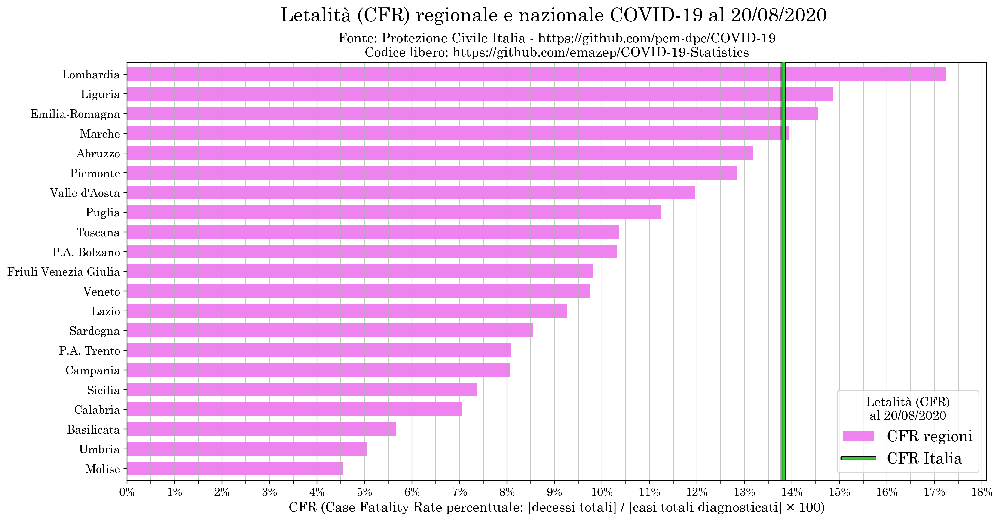

In [44]:
# CFR
ALPHA = 0.7
BAR_WIDTH = 0.3
pe_shadow_lateral = pe.SimpleLineShadow(offset=(-2,0), alpha=0.4)

last_date_str = ds_reg_last_day.index.max().strftime('%d/%m/%Y')
ds_reg_last_day_sorted = ds_reg_last_day.sort_values(by='CFR')

x='denominazione_regione'
y='CFR'

ax = ds_reg_last_day_sorted.plot.barh(
    x, y, figsize=(16,8), color='violet', label='CFR regioni', zorder=0, width=0.7
)

ax.xaxis.set_major_locator(ticker.MultipleLocator(0.01))
ax.xaxis.set_minor_locator(ticker.MultipleLocator(0.005))
ax.xaxis.set_major_formatter(ticker.PercentFormatter(xmax=1, decimals=0))
ax.tick_params(axis='x', which='both', labelsize=12)
ax.xaxis.grid(which='both', alpha=ALPHA)
plt.xlabel('CFR (Case Fatality Rate percentuale: [decessi totali] / [casi totali diagnosticati] × 100)', fontsize=14)

ax.tick_params(axis='y', which='both', labelsize=12)
plt.ylabel(None)

last_index = ds_it.index.max()
CFR_Italy = ds_it.loc[last_index, 'deceduti'] / ds_it.loc[last_index, 'totale_casi']
plt.axvline(x=CFR_Italy, zorder=3, color='limegreen', linewidth=3, path_effects=[pe_outline, pe_shadow_lateral, pe_normal], label='CFR Italia')

handles, labels = ax.get_legend_handles_labels()
ax.legend(reversed(handles), reversed(labels), title='Letalità (CFR)\n al '+last_date_str, fontsize=16)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('    Letalità (CFR) regionale e nazionale COVID-19 al '+last_date_str, fontsize=20)

fig_CFR = plt.gcf()

plt.show()

In [45]:
ds_prov = province_data_load()
ds_prov.loc[ds_prov['denominazione_provincia'] == 'Alessandria']

,stato,codice_regione,denominazione_regione,codice_provincia,denominazione_provincia,sigla_provincia,lat,long,totale_casi,note
data,,,,,,,,,,
2020-02-24,ITA,1,Piemonte,6,Alessandria,AL,44.912974,8.615401,0,NaN
2020-02-25,ITA,1,Piemonte,6,Alessandria,AL,44.912974,8.615401,0,NaN
2020-02-26,ITA,1,Piemonte,6,Alessandria,AL,44.912974,8.615401,0,NaN
2020-02-27,ITA,1,Piemonte,6,Alessandria,AL,44.912974,8.615401,0,NaN
2020-02-28,ITA,1,Piemonte,6,Alessandria,AL,44.912974,8.615401,0,NaN
...,...,...,...,...,...,...,...,...,...,...
2020-08-16,ITA,1,Piemonte,6,Alessandria,AL,44.912974,8.615401,4139,NaN
2020-08-17,ITA,1,Piemonte,6,Alessandria,AL,44.912974,8.615401,4140,NaN
2020-08-18,ITA,1,Piemonte,6,Alessandria,AL,44.912974,8.615401,4140,NaN


In [46]:
ds_province_sided = province_data_reshaping(ds_prov)
ds_province_sided.tail(10)

,totale_casi_Bergamo,totale_casi_DELTA_Bergamo,totale_casi_Brescia,totale_casi_DELTA_Brescia,totale_casi_Cremona,totale_casi_DELTA_Cremona,totale_casi_Lodi,totale_casi_DELTA_Lodi,totale_casi_Milano,totale_casi_DELTA_Milano,totale_casi_Pavia,totale_casi_DELTA_Pavia,totale_casi_Piacenza,totale_casi_DELTA_Piacenza,totale_casi_Torino,totale_casi_DELTA_Torino,totale_casi_Alessandria,totale_casi_DELTA_Alessandria
data,,,,,,,,,,,,,,,,,,
2020-08-11,15119,2.0,16035,14.0,6749,1.0,3647,0.0,25100,21.0,5634,1.0,4543,-1.0,16046,19.0,4129,0.0
2020-08-12,15125,6.0,16046,11.0,6751,2.0,3652,5.0,25129,29.0,5636,2.0,4545,2.0,16054,8.0,4131,2.0
2020-08-13,15128,3.0,16054,8.0,6752,1.0,3653,1.0,25157,28.0,5639,3.0,4548,3.0,16057,3.0,4132,1.0
2020-08-14,15135,7.0,16066,12.0,6753,1.0,3654,1.0,25187,30.0,5647,8.0,4553,5.0,16064,7.0,4133,1.0
2020-08-15,15140,5.0,16085,19.0,6756,3.0,3654,0.0,25221,34.0,5653,6.0,4561,8.0,16074,10.0,4138,5.0
2020-08-16,15145,5.0,16094,9.0,6756,0.0,3654,0.0,25246,25.0,5653,0.0,4562,1.0,16085,11.0,4139,1.0
2020-08-17,15151,6.0,16098,4.0,6756,0.0,3655,1.0,25256,10.0,5654,1.0,4566,4.0,16089,4.0,4140,1.0
2020-08-18,15164,13.0,16102,4.0,6756,0.0,3655,0.0,25271,15.0,5657,3.0,4567,1.0,16099,10.0,4140,0.0
2020-08-19,15177,13.0,16123,21.0,6758,2.0,3657,2.0,25297,26.0,5660,3.0,4572,5.0,16120,21.0,4140,0.0


In [47]:
BAR_WIDTH = 0.75

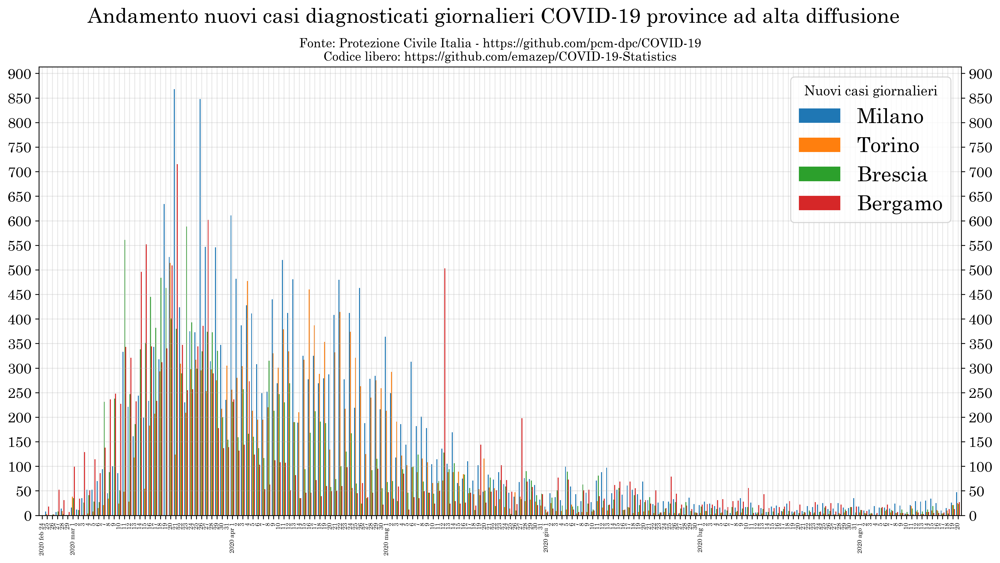

In [48]:
# Critical province trend
SLACK = 0.3
ALPHA = 0.3

PROVINCE = ['Milano', 'Torino', 'Brescia', 'Bergamo']
COLUMN = 'totale_casi_DELTA'

plot_columns = localize_plot_column(COLUMN, PROVINCE)

ds_province_group = make_province_group_w_ra(ds_province_sided, plot_columns, days=7)

ax = ds_province_group.plot.bar(y=plot_columns, label=PROVINCE, figsize=(16, 8), zorder=1, width=BAR_WIDTH)
#color=['r', 'limegreen', 'mediumblue']

ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates_from_numbers(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE, rotation=90)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(50))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=14)
ax.set_ylim(bottom=0)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

ax.legend(title='Nuovi casi giornalieri', fontsize=20)

ax.set_title(SUBTITLE_NO_CORR, fontsize=12)
plt.suptitle('   Andamento nuovi casi diagnosticati giornalieri COVID-19 province ad alta diffusione', fontsize=20)

fig_daily_incr_province_high = plt.gcf()

plt.show()

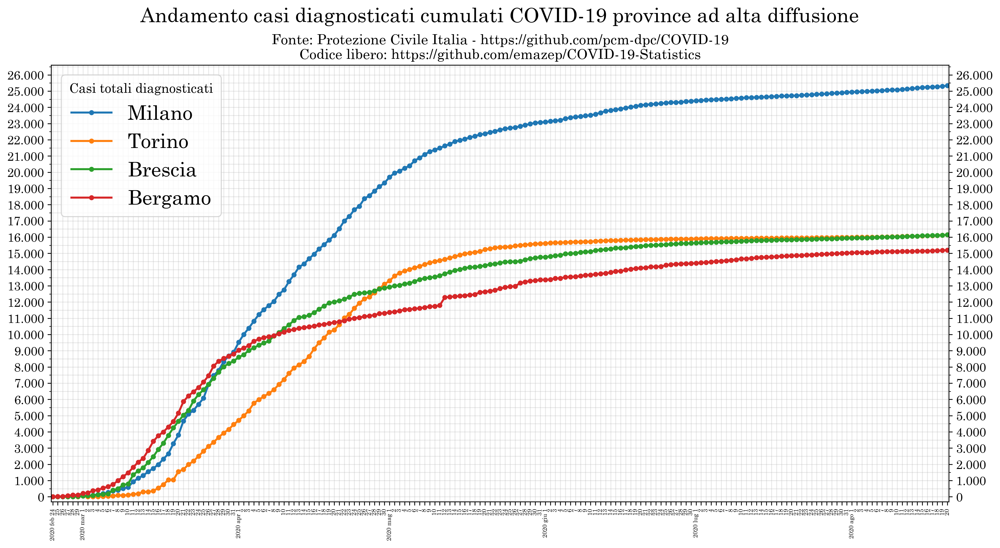

In [49]:
# High province cumulated trend
SLACK = 0.3
ALPHA = 0.3

PROVINCE = ['Milano', 'Torino', 'Brescia', 'Bergamo']
COLUMN = 'totale_casi'

plot_columns = localize_plot_column(COLUMN, PROVINCE)

ax = ds_province_sided.plot(y=plot_columns, label=PROVINCE, figsize=(16, 8), zorder=2, **small_plt_params)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE, rotation=90)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(1000))
ax.yaxis.set_minor_locator(ticker.MultipleLocator(500))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=12)

ax.set_ylim(bottom=-300)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

#handles, labels = ax.get_legend_handles_labels()
#ax.legend(reversed(handles), reversed(labels), title='Casi totali diagnosticati', fontsize=24)
ax.legend(title='Casi totali diagnosticati', fontsize=20)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('     Andamento casi diagnosticati cumulati COVID-19 province ad alta diffusione', fontsize=20)

fig_cum_province_high = plt.gcf()

plt.show()

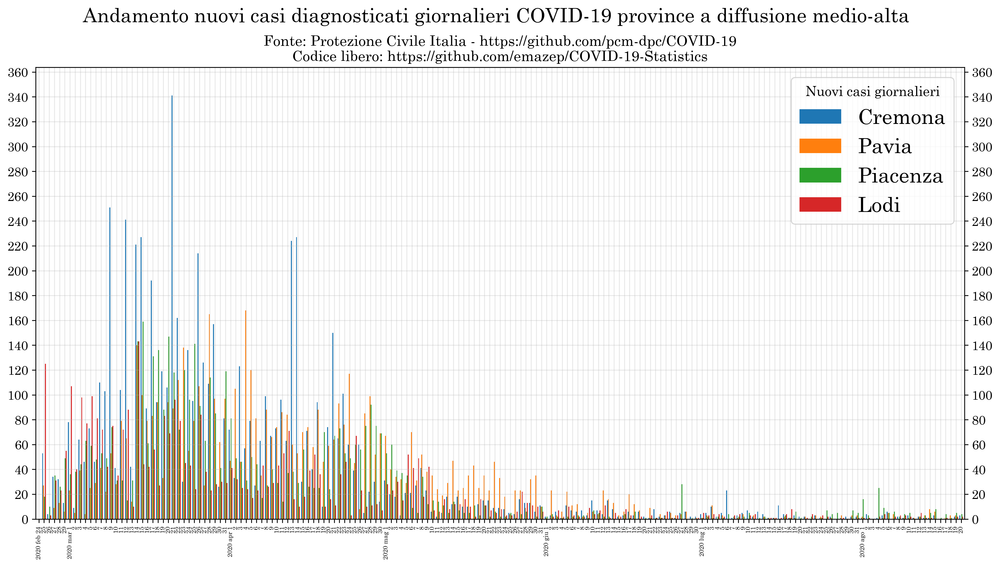

In [50]:
# Medium-high province daily incr trend
SLACK = 0.3
ALPHA = 0.3

PROVINCE = ['Cremona', 'Pavia', 'Piacenza', 'Lodi']
COLUMN = 'totale_casi_DELTA'

plot_columns = localize_plot_column(COLUMN, PROVINCE)

ds_province_group = make_province_group_w_ra(ds_province_sided, plot_columns, days=7)

ax = ds_province_group.plot.bar(y=plot_columns, label=PROVINCE, figsize=(16, 8), zorder=1, width=BAR_WIDTH)

ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates_from_numbers(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE, rotation=90)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(20))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=12)
ax.set_ylim(bottom=0)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

ax.legend(title='Nuovi casi giornalieri', fontsize=20)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('    Andamento nuovi casi diagnosticati giornalieri COVID-19 province a diffusione medio-alta', fontsize=19)

fig_daily_incr_province_medium_high = plt.gcf()

plt.show()

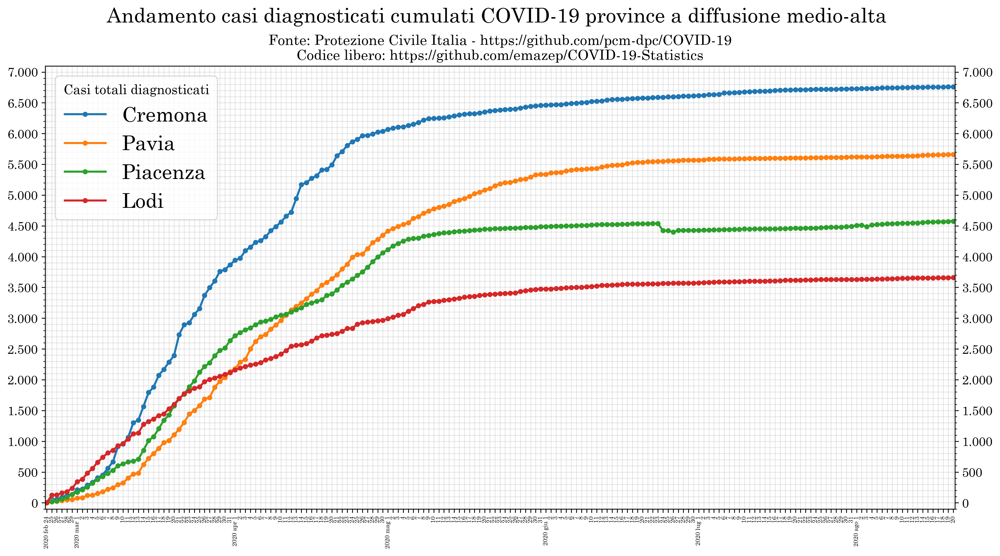

In [51]:
# Medium-high province cumulated trend
SLACK = 0.3
ALPHA = 0.3

PROVINCE = ['Cremona', 'Pavia', 'Piacenza', 'Lodi']
COLUMN = 'totale_casi'

plot_columns = localize_plot_column(COLUMN, PROVINCE)

ax = ds_province_sided.plot(y=plot_columns, label=PROVINCE, figsize=(16, 8), zorder=2, **small_plt_params)

set_xlim(ax, SLACK)

ax.xaxis.set_major_locator(mdates.DayLocator())
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format_dates(x, p, rotate=True)))
ax.tick_params(axis='x', which='both', labelsize=DATE_SIZE, rotation=90)
ax.xaxis.grid(True, which='both')

ax.yaxis.grid(True, which='both')
ax.yaxis.set_major_locator(ticker.MultipleLocator(500))
ax.yaxis.set_minor_locator(ticker.MultipleLocator(100))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: f'{x:n}'))
ax.tick_params(axis='y', which='both', labelsize=12)

ax.set_ylim(bottom=-100)

ax.grid(which='both', alpha=ALPHA)
ax.tick_params(axis='y', which='both', right=True, labelright=True)

plt.xlabel(None)

#handles, labels = ax.get_legend_handles_labels()
#ax.legend(reversed(handles), reversed(labels), title='Casi totali diagnosticati', fontsize=24)
ax.legend(title='Casi totali diagnosticati', fontsize=20)

ax.set_title(SUBTITLE_NO_CORR, fontsize=14)
plt.suptitle('    Andamento casi diagnosticati cumulati COVID-19 province a diffusione medio-alta', fontsize=20)

fig_cum_province_medium_high = plt.gcf()

plt.show()

In [52]:
with save_in_dir(OUTPUT_PATH):
    fig_daily_incr.savefig('01_daily_incr_ita.png', transparent=False)
    fig_90_days_daily_cases_deaths.savefig('02_90_days_daily_cases_deaths.png', transparent=False)
    fig_trend.savefig('03_trend_ita.png', transparent=False)
    fig_current.savefig('04_current_ita.png', transparent=False)
    fig_hospital.savefig('05_hospital_ita.png', transparent=False)
    fig_ICU.savefig('06_ICU_ita.png', transparent=False)
    fig_exitus.savefig('07_exitus_ita.png', transparent=False)
    fig_tests.savefig('08_tests_ita.png', transparent=False)
    fig_growth.savefig('09_growth_factor_ita.png', transparent=False)

In [53]:
with save_in_dir(OUTPUT_PATH):
    fig_daily_incr_regions_Lombardia.savefig('10_daily_incr_Lombardia.png', transparent=False)
    fig_cum_Lombardia.savefig('11_cum_Lombardia.png', transparent=False)
    fig_tests_Lombardia.savefig('12_tests_Lombardia.png', transparent=False)
    fig_growth_Lombardia.savefig('13_growth_factor_Lombardia.png', transparent=False)

In [54]:
with save_in_dir(OUTPUT_PATH):
    fig_daily_incr_regions_high.savefig('14_daily_incr_regions_high.png', transparent=False)
    fig_cum_regions_high.savefig('15_cum_regions_high.png', transparent=False)

    fig_daily_incr_regions_medium_high.savefig('16_daily_incr_regions_medium_high.png', transparent=False)
    fig_cum_regions_medium_high.savefig('17_cum_regions_medium_high.png', transparent=False)

    fig_daily_incr_regions_medium.savefig('18_daily_incr_regions_medium.png', transparent=False)
    fig_cum_regions_medium.savefig('19_cum_regions_medium.png', transparent=False)

    fig_daily_incr_regions_medium_low.savefig('20_daily_incr_regions_medium_low.png', transparent=False)
    fig_cum_regions_medium_low.savefig('21_cum_regions_medium_low.png', transparent=False)

    fig_daily_incr_regions_low.savefig('22_daily_incr_regions_low.png', transparent=False)
    fig_cum_regions_low.savefig('23_cum_regions_low.png', transparent=False)

In [55]:
with save_in_dir(OUTPUT_PATH):
    fig_density.savefig('24_density.png', transparent=False)
    fig_regional_test_RATIO.savefig('25_regional_test_RATIO.png', transparent=False)
    fig_R0.savefig('26_R0.png', transparent=False)
    fig_CFR.savefig('27_CFR.png', transparent=False)

In [56]:
with save_in_dir(OUTPUT_PATH):
    fig_daily_incr_province_high.savefig('28_daily_incr_province_high.png', transparent=False)
    fig_cum_province_high.savefig('29_daily_incr_province_high.png', transparent=False)
    fig_daily_incr_province_medium_high.savefig('30_cum_province_medium_high.png', transparent=False)
    fig_cum_province_medium_high.savefig('31_cum_province_medium_high.png', transparent=False)

In [57]:
os.getcwd()

'C:\\Users\\emaze\\Dropbox\\Works\\COVID-19-Statistics\\src'